# Step 1 Import all essential libraries

In [1]:
import numpy as np
import cv2
import glob
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import os
import pickle
from moviepy.editor import VideoFileClip
from IPython.display import HTML
%matplotlib inline
print("Step 1 Complete - All Libraries Imported")

Step 1 Complete - All Libraries Imported


# Step 2 Setup for Camera Calibration

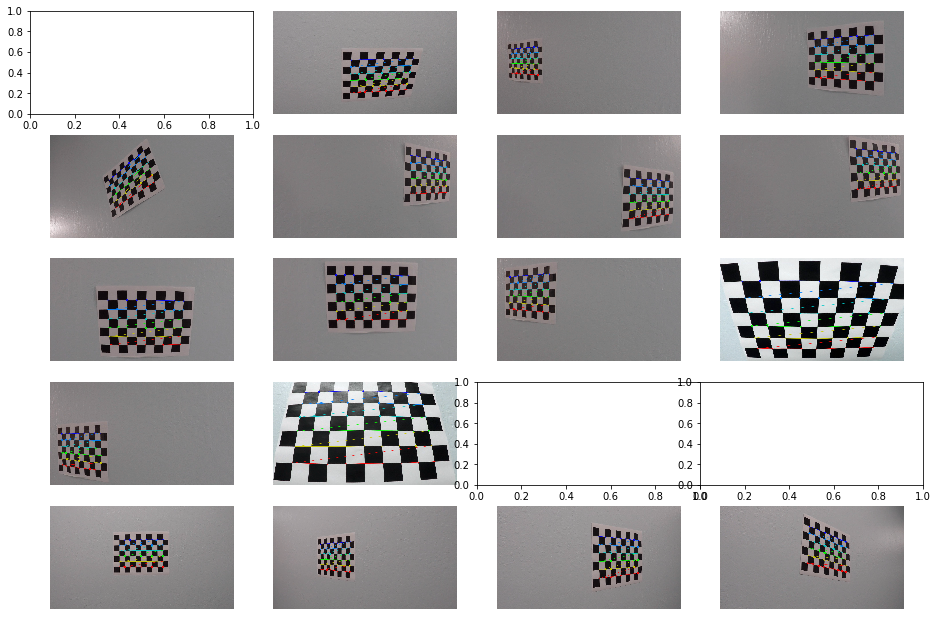

In [2]:
# Prepare object points, like (0,0,0), (1,0,0), (2,0,0) ....,(6,5,0)
objp = np.zeros((6*9,3), np.float32)
objp[:,:2] = np.mgrid[0:9, 0:6].T.reshape(-1,2)

# Termination criteria used 
# Reference: http://docs.opencv.org/3.0-beta/doc/py_tutorials/py_calib3d/py_calibration/py_calibration.html
criteria = (cv2.TERM_CRITERIA_EPS + cv2.TERM_CRITERIA_MAX_ITER, 30, 0.001)

# Arrays to store object points and image points from all the images.
objpoints = [] # 3d points in real world space
imgpoints = [] # 2d points in image plane.

# Make a list of calibration images
images = glob.glob('./camera_cal/calibration*.jpg')

fig, axs = plt.subplots(5,4, figsize=(16, 11))
fig.subplots_adjust(hspace = .2, wspace=.001)
axs = axs.ravel()

# Step through the list and search for chessboard corners
for idx, fname in enumerate(images):
    img = cv2.imread(fname)
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

    # Find the chessboard corners - The tweak here is to use the chess board corners as (9, 6) instead of (8, 6) in lessons
    ret, corners = cv2.findChessboardCorners(gray, (9,6), None)
    
    # If found, add object points, image points
    if ret == True:
        objpoints.append(objp)
        # Improve accuracy of corners Reference: http://docs.opencv.org/3.0-beta/doc/py_tutorials/py_calib3d/py_calibration/py_calibration.html
        accurate_corners = cv2.cornerSubPix(gray,corners,(11,11),(-1,-1),criteria)
        imgpoints.append(accurate_corners)

        # Draw and display the corners. Adjust drawing of chessboard corners to (9,6)
        cv2.drawChessboardCorners(img, (9,6), accurate_corners, ret)
        axs[idx].axis('off')
        axs[idx].imshow(img)
#         cv2.imshow('img',img) #Does not work
#         write_name = 'corners_found'+str(idx)+'.jpg'
#         cv2.imwrite(write_name, img)

## Step 3 Find Camera Matrix, Distortion Co-efficients and Test Undistortion on images

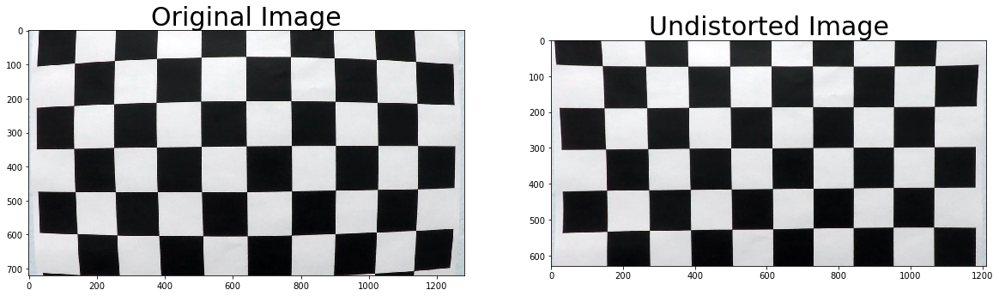

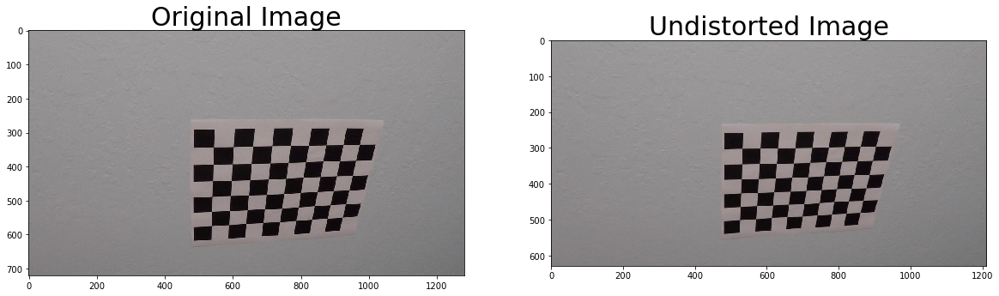

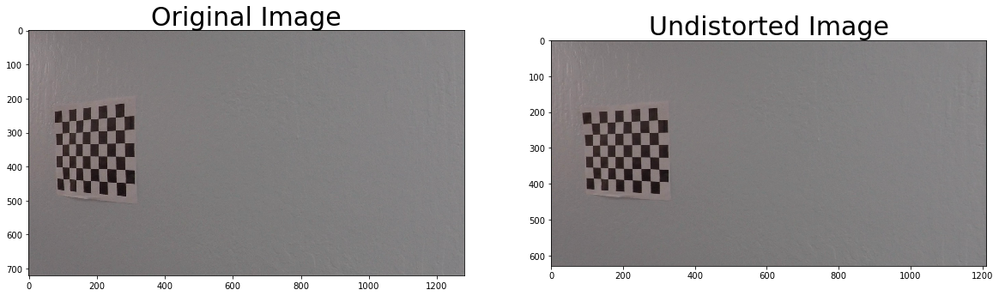

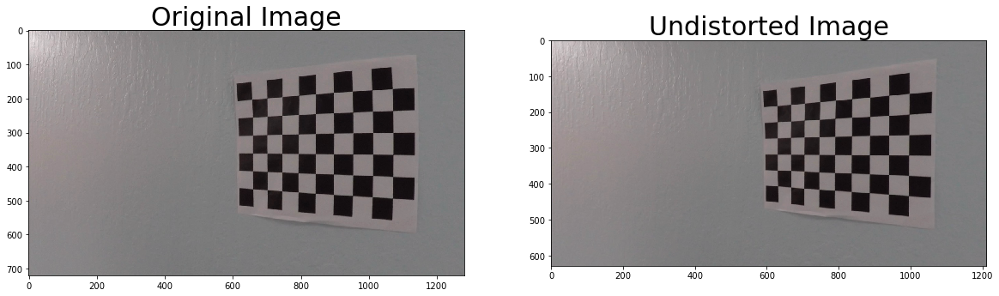

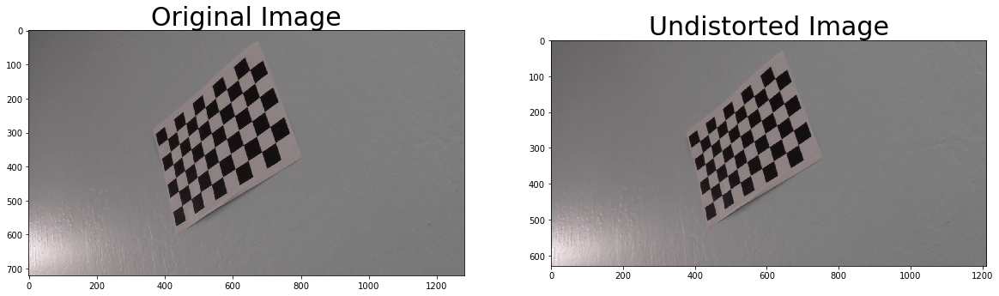

...

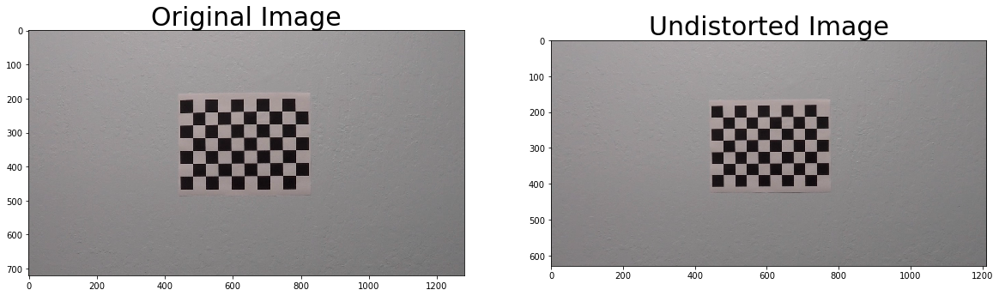

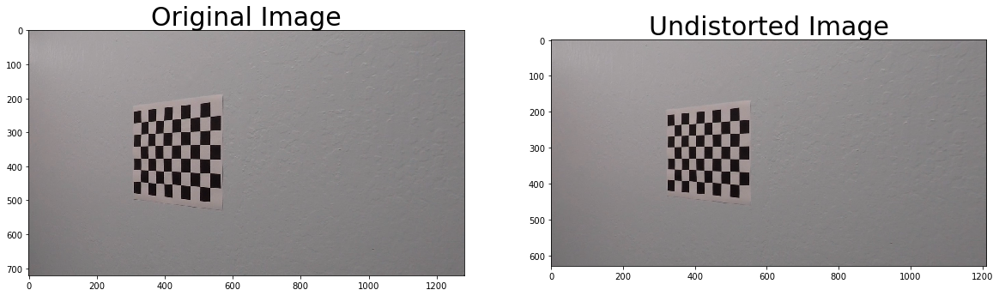

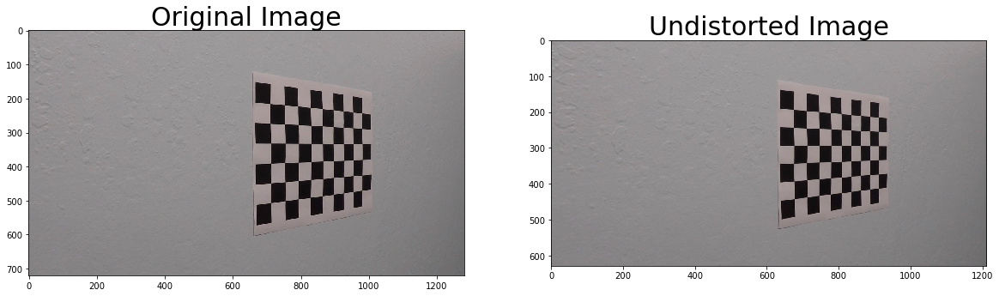

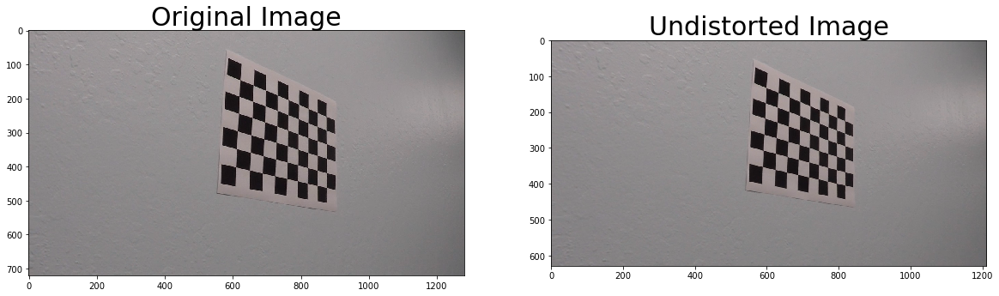

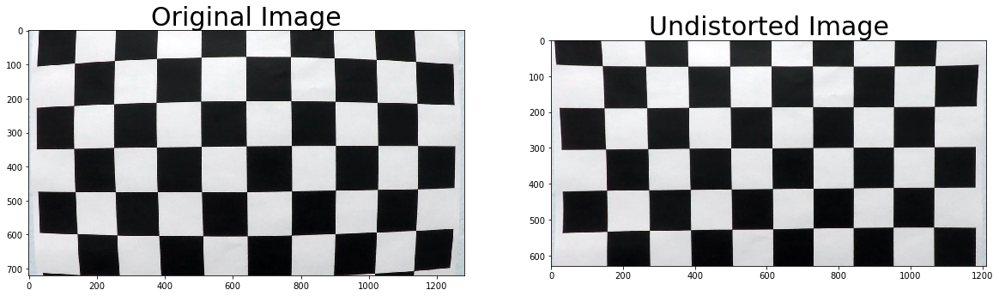

In [3]:
# The technique learnt in the lesson have been applied to all images
# Initialize pickle dictionary - Use for pickle dump
dist_pickle = {}
for idx, fname in enumerate(images):
    # Read each image to undistort
    img = cv2.imread(fname)
    
    #Identify the dimensions
    img_size = (img.shape[1], img.shape[0])
    
    
    #Calibrate camera
    ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, img_size, None, None)
    
    #Undistort images
    #Step 1- Get Optimal New Camera Matrix
    h, w = img.shape[:2]
    newcameramtx, roi=cv2.getOptimalNewCameraMatrix(mtx,dist,(w,h),1,(w,h))
    #dst = cv2.undistort(img, mtx, dist, None, mtx)
    
    #Step 2a- Undistort image shortest path
    #dst = cv2.undistort(img, mtx, dist, None, newcameramtx)
    
    #Step 2b - Undistort image curved path
    mapx,mapy = cv2.initUndistortRectifyMap(mtx,dist,None,newcameramtx,(w,h),5)
    dst = cv2.remap(img,mapx,mapy,cv2.INTER_LINEAR)
        
    # Step 3b - Crop image 
    x,y,w,h = roi
    dst = dst[y:y+h, x:x+w]
#     cv2.imwrite('calibresult.png',dst)
    
    #Create a dictionary to dump undistorted image data into a pickle file
#     dist_pickle["mtx"] = mtx
#     dist_pickle["dist"] = dist
    # Correct Functionality for Pickle Dump
    dist_pickle[fname] = mtx
    dist_pickle[fname+"_dist"] = dist
    #dst = cv2.cvtColor(dst, cv2.COLOR_BGR2RGB)

    # Visualize undistortion
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
    ax1.imshow(img)
    ax1.set_title('Original Image', fontsize=30)
    ax2.imshow(dst)
    ax2.set_title('Undistorted Image', fontsize=30)

#Dump all undistorted images into a pickle file
pickle.dump(dist_pickle, open( "calibration.p", "wb" ))

# Pickle single image calibration for testing purposes
# Test undistortion on an image from Camera Calibration Images folder
img = cv2.imread('./camera_cal/calibration1.jpg')
img_size = (img.shape[1], img.shape[0])

# Do camera calibration given object points and image points
ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, img_size, None, None)

h, w = img.shape[:2]
newcameramtx, roi=cv2.getOptimalNewCameraMatrix(mtx,dist,(w,h),1,(w,h))
# Undistort image - without Optimal new camera matrix
# dst = cv2.undistort(img, mtx, dist, None, mtx)
# Undistort image - with Optimal new camera matrix
# dst = cv2.undistort(img, mtx, dist, None, newcameramtx)
# cv2.imwrite('./camera_cal/calibration1_undist.jpg',dst)

#Step 2b - Undistort image curved path
mapx,mapy = cv2.initUndistortRectifyMap(mtx,dist,None,newcameramtx,(w,h),5)
dst = cv2.remap(img,mapx,mapy,cv2.INTER_LINEAR)

x,y,w,h = roi
dst = dst[y:y+h, x:x+w]
cv2.imwrite('calibresult.png',dst)

# Save the camera calibration result for later use (we won't worry about rvecs / tvecs)
dist_pickle = {}
dist_pickle["mtx"] = mtx
dist_pickle["dist"] = dist
pickle.dump( dist_pickle, open( "calibration1.p", "wb" ) )
#dst = cv2.cvtColor(dst, cv2.COLOR_BGR2RGB)
# Visualize undistortion
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
ax1.imshow(img)
ax1.set_title('Original Image', fontsize=30)
ax2.imshow(dst)
ax2.set_title('Undistorted Image', fontsize=30)

## Step 4 Applying Undistortion To Input Images

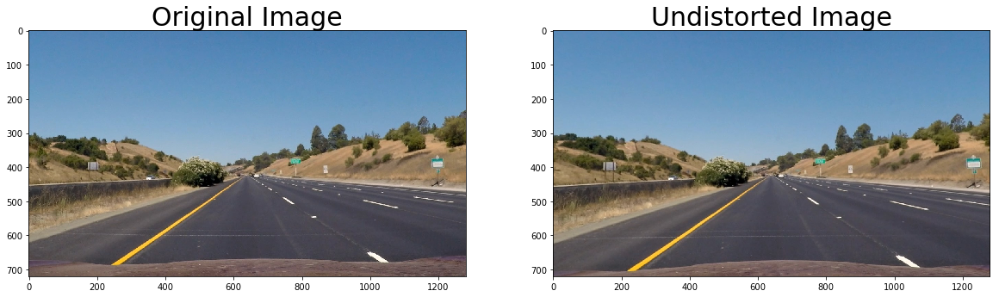

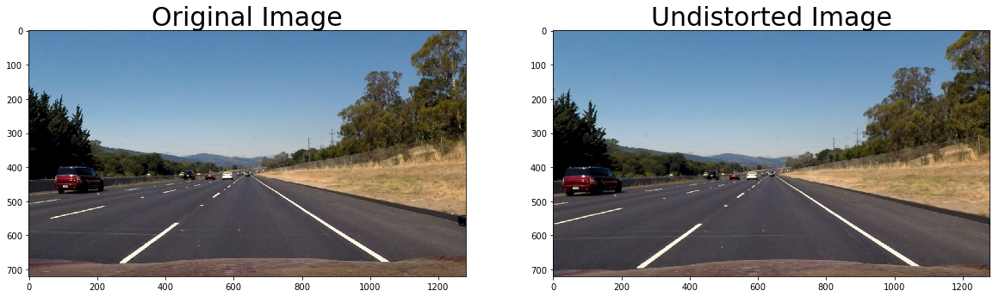

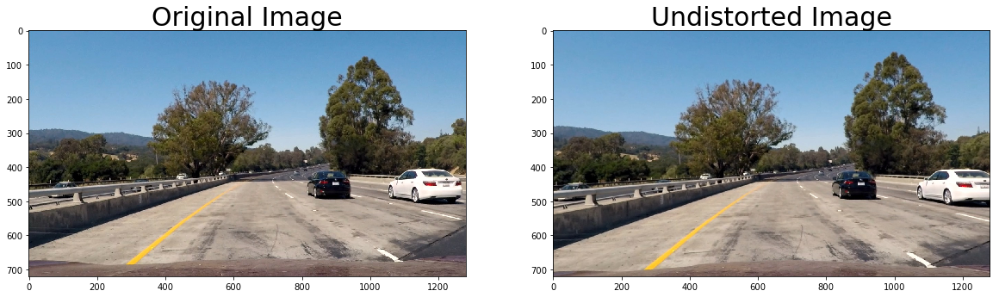

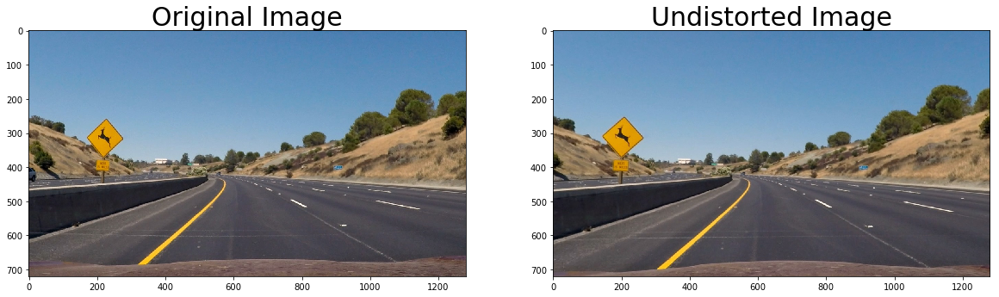

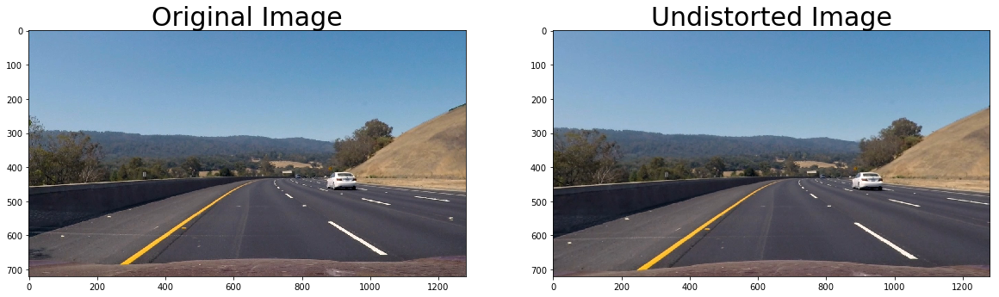

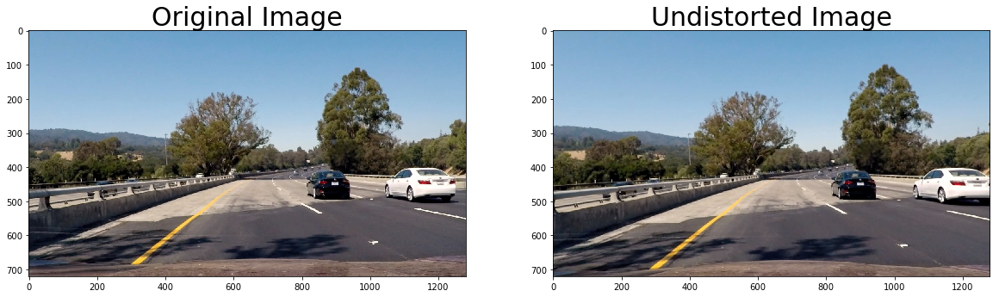

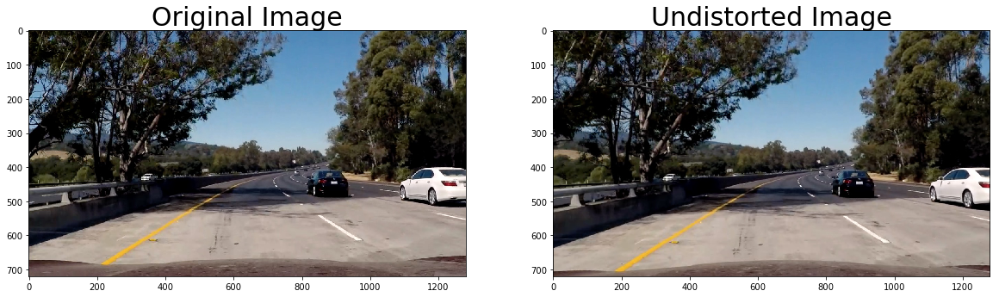

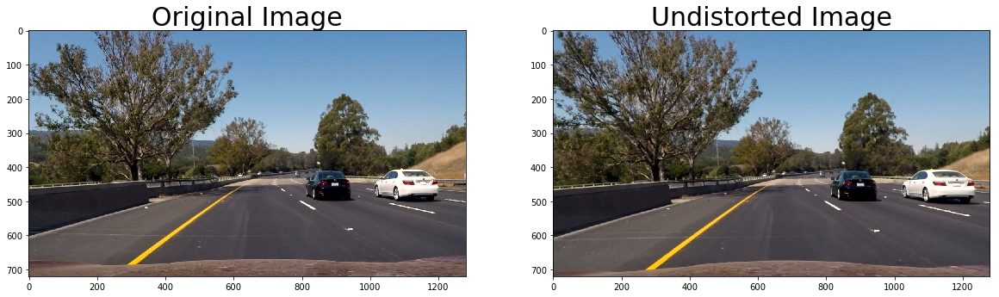

In [4]:
# Using Undistort approach for curved path instead of shortest path.
# Reference: http://docs.opencv.org/3.0-beta/doc/py_tutorials/py_calib3d/py_calibration/py_calibration.html
def undistort_image(img):
    h, w = img.shape[:2]
    newcameramtx, roi=cv2.getOptimalNewCameraMatrix(mtx,dist,(w,h),1,(w,h))
    mapx,mapy = cv2.initUndistortRectifyMap(mtx,dist,None,newcameramtx,(w,h),5)
    dst = cv2.remap(img,mapx,mapy,cv2.INTER_LINEAR)

    x,y,w,h = roi
    undist_img = dst[y:y+h, x:x+w]
    return undist_img

# Using Undistort approach for shortest path
def undistort(img):
    undist = cv2.undistort(img, mtx, dist, None, mtx)
    return undist

test_images = glob.glob('./test_images/*.jpg')
for idx, fname in enumerate(test_images):
    test_image = cv2.imread(fname)
    test_image = cv2.cvtColor(test_image, cv2.COLOR_BGR2RGB)
    #undist_image = undistort_image(test_image)
    undist_image = undistort(test_image)
    # Visualize undistortion
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
    ax1.imshow(test_image)
    ax1.set_title('Original Image', fontsize=30)
    ax2.imshow(undist_image)
    ax2.set_title('Undistorted Image', fontsize=30)
    #Saving Undistorted Images for next step of processing
    cv2.imwrite('./output_images/test'+str(idx)+'_undist.jpg',undist_image)

## Step 5 Applying Perspective Transform

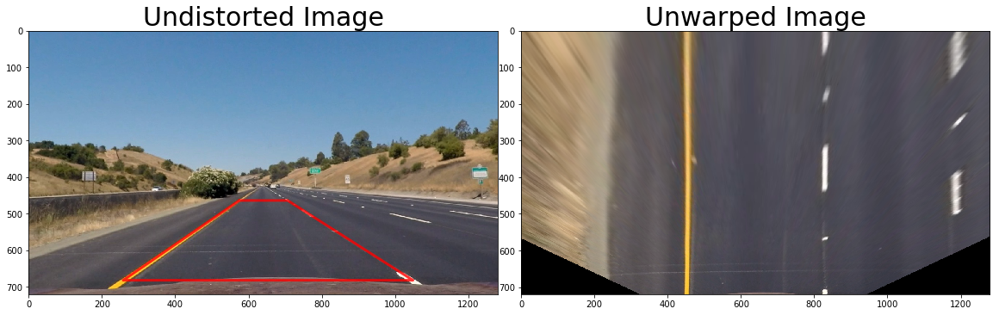

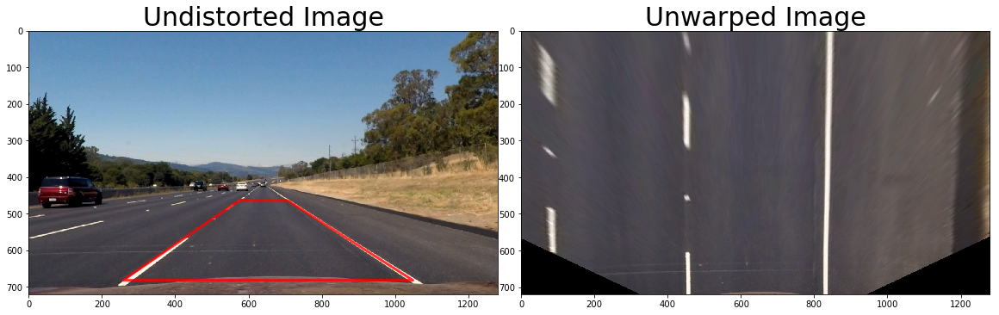

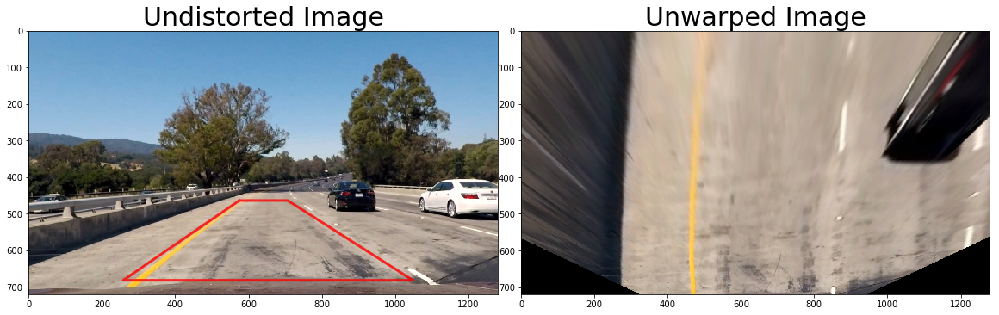

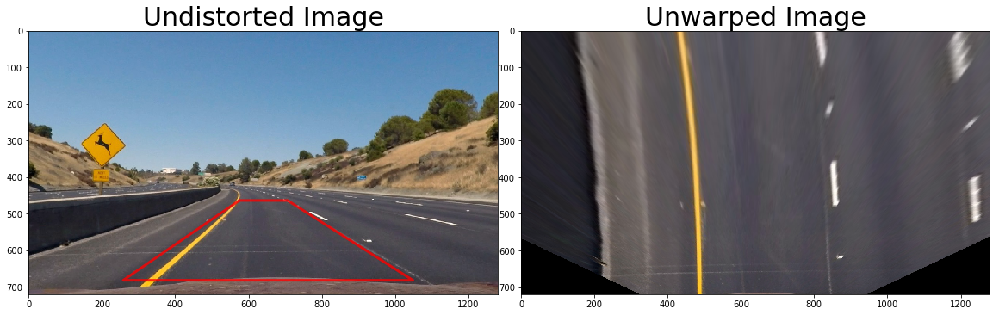

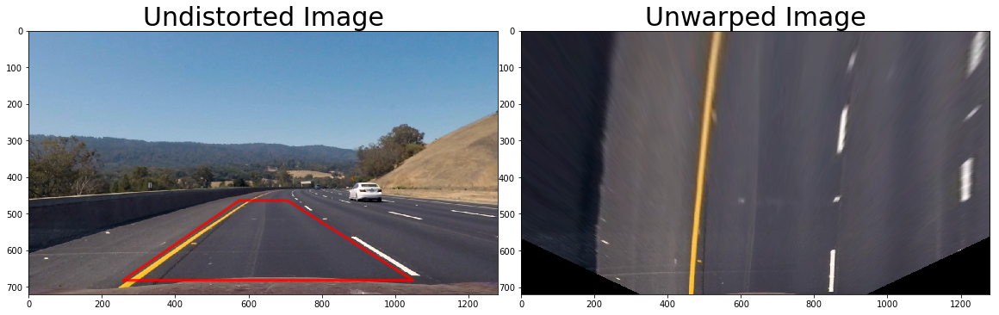

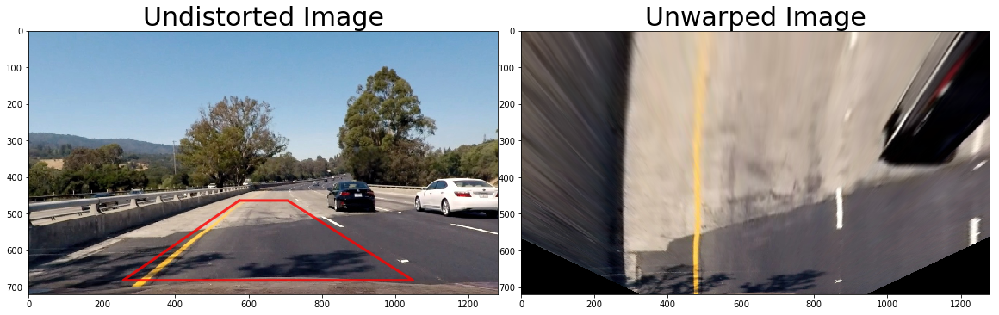

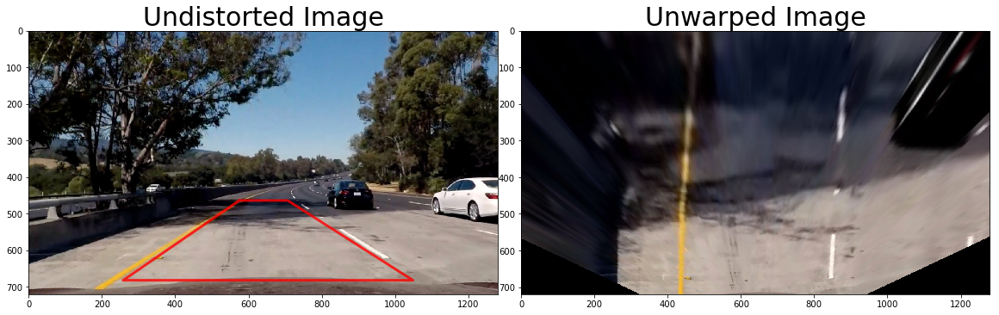

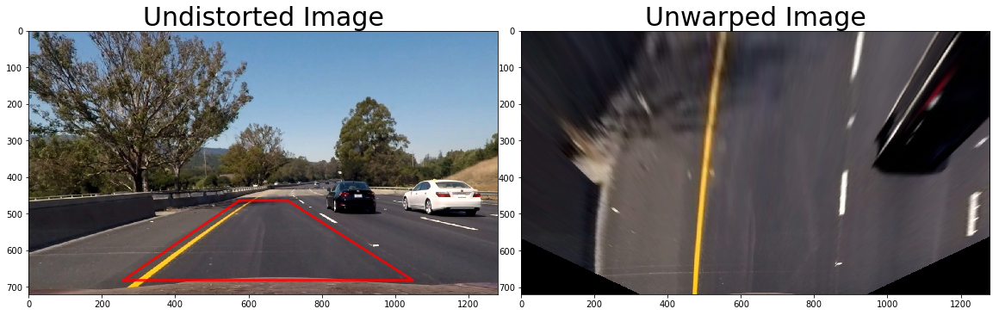

In [5]:
def unwarp(img, src, dst):
    h,w = img.shape[:2]
    # use cv2.getPerspectiveTransform() to get M, the transform matrix, and Minv, the inverse
    M = cv2.getPerspectiveTransform(src, dst)
    Minv = cv2.getPerspectiveTransform(dst, src)
    # use cv2.warpPerspective() to warp your image to a top-down view
    warped = cv2.warpPerspective(img, M, (w,h), flags=cv2.INTER_LINEAR)
    return warped, M, Minv

def warp_image(img, src, dst):
    # Compute and apply perpective transform
    img_size = (img.shape[1], img.shape[0])
    #h, w = img.shape[:2]
    M = cv2.getPerspectiveTransform(src, dst)
    Minv = cv2.getPerspectiveTransform(dst, src)
    warped = cv2.warpPerspective(img, M, img_size, flags=cv2.INTER_LINEAR)  # keep same size as input image    
    #warped = cv2.warpPerspective(img, M, (h, w), flags=cv2.INTER_LINEAR)  # keep same size as input image    
    return warped, M, Minv

def find_polygon(xsize, ysize):
    point1 = (int(xsize*0.11),int(ysize))
    #print(point1)
    point2 = (int(xsize*0.44),int(ysize*0.60))
    #print(point2)
    point3 = (int(xsize*0.57),int(ysize*0.60))
    #print(point3)
    point4 = (int(xsize*0.97),int(ysize))
    #print(point4)
    return([point1,point2,point3,point4])

# define source and destination points for transform
src = np.float32([(575,464),
                  (707,464), 
                  (258,682), 
                  (1049,682)])

undistort_test_images = glob.glob('./output_images/test*_undist.jpg')
for idx, fname in enumerate(undistort_test_images):
    undist_image = cv2.imread(fname)
    h,w = undist_image.shape[:2]
    #print("Height and Width:"+str(h)+","+str(w))
    #print("Image Size:"+str(undist_image[1])+","+str(undist_image[0]))
    
    dst = np.float32([(450,0),
                  (w-450,0),
                  (450,h),
                  (w-450,h)])
    #unwarped_image, M, Minv = warp_image(undist_image, src, dst)
    unwarped_image, M, Minv = unwarp(undist_image, src, dst)

    # Visualize unwarp
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
    f.subplots_adjust(hspace = .2, wspace=.05)
    ax1.imshow(undist_image)
    
    #Draw Quadrilateral on the original undistorted image for painting lanes in pipeline
    #vertices = find_polygon(h, w)
#     x = [vertices[0][0],vertices[2][0],vertices[3][0],vertices[1][0],vertices[0][0]]
#     y = [vertices[0][1],vertices[2][1],vertices[3][1],vertices[1][1],vertices[0][1]]
#     print('Vertices X:',x)
#     print('Vertices Y:',y)    
    x = [src[0][0],src[2][0],src[3][0],src[1][0],src[0][0]]
    y = [src[0][1],src[2][1],src[3][1],src[1][1],src[0][1]]
#     print('Vertices X:',x)
#     print('Vertices Y:',y)    

    #Draw Quadrilateral
    ax1.plot(x, y, color='red', alpha=0.8, linewidth=3, solid_capstyle='round', zorder=2)
    ax1.set_ylim([h,0])
    ax1.set_xlim([0,w])
    ax1.set_title('Undistorted Image', fontsize=30)
    ax2.imshow(unwarped_image)
    ax2.set_title('Unwarped Image', fontsize=30)
    cv2.imwrite('./output_images/warp/test_unwarp'+str(idx)+'.jpg', unwarped_image)

## Step 6 Explore Color Channels

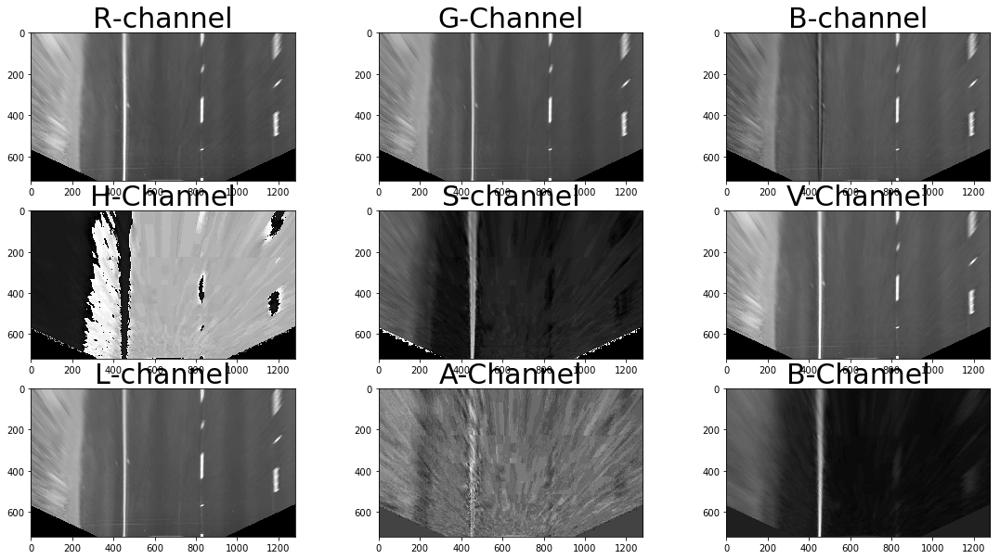

In [6]:
unwarp_image_check = cv2.imread('./output_images/warp/test_unwarp0.jpg')
# Explore RGB Color Channels
unwarp_image_check_R = unwarp_image_check[:,:,0]
unwarp_image_check_G = unwarp_image_check[:,:,1]
unwarp_image_check_B = unwarp_image_check[:,:,2]

#Explore HSV channel
unwarp_image_check_HSV = cv2.cvtColor(unwarp_image_check, cv2.COLOR_RGB2HSV)
unwarp_image_check_H   = unwarp_image_check_HSV[:,:,0]
unwarp_image_check_S   = unwarp_image_check_HSV[:,:,1]
unwarp_image_check_V   = unwarp_image_check_HSV[:,:,2]

#Explore Lab Channel
unwarp_image_check_LAB = cv2.cvtColor(unwarp_image_check, cv2.COLOR_RGB2Lab)
unwarp_image_check_L   = unwarp_image_check_LAB[:,:,0]
unwarp_image_check_A   = unwarp_image_check_LAB[:,:,1]
unwarp_image_check_B2  = unwarp_image_check_LAB[:,:,2]

fig, axs = plt.subplots(3,3, figsize=(20,10))
fig.subplots_adjust(hspace = .2, wspace=.02)
axs = axs.ravel()
axs[0].imshow(unwarp_image_check_R, cmap='gray')
axs[0].set_title('R-channel', fontsize=30)
axs[1].imshow(unwarp_image_check_G, cmap='gray')
axs[1].set_title('G-Channel', fontsize=30)
axs[2].imshow(unwarp_image_check_B, cmap='gray')
axs[2].set_title('B-channel', fontsize=30)
axs[3].imshow(unwarp_image_check_H, cmap='gray')
axs[3].set_title('H-Channel', fontsize=30)
axs[4].imshow(unwarp_image_check_S, cmap='gray')
axs[4].set_title('S-channel', fontsize=30)
axs[5].imshow(unwarp_image_check_V, cmap='gray')
axs[5].set_title('V-Channel', fontsize=30)
axs[6].imshow(unwarp_image_check_L, cmap='gray')
axs[6].set_title('L-channel', fontsize=30)
axs[7].imshow(unwarp_image_check_A, cmap='gray')
axs[7].set_title('A-Channel', fontsize=30)
axs[8].imshow(unwarp_image_check_B2, cmap='gray')
axs[8].set_title('B-Channel', fontsize=30)

## Step 7 Testing thresholds - Absolute, Magnitude, Direction and Color

In [7]:
def abs_sobel_thresh(img, orient='x', kernel_size=3, thresh=(0, 255)):
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY) #Convert to gray scale
    #Call Sobel filter based on the orientation
    if orient == 'x': 
        sobel = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=kernel_size)
    elif orient == 'y':
        sobel = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=kernel_size)
    #Get the absolute value of Sobel filter
    abs_sobel = np.absolute(sobel)
    scaled_sobel = np.uint8(abs_sobel / np.max(abs_sobel) * 255)
    abs_threshold = np.zeros_like(scaled_sobel)
    abs_threshold[(scaled_sobel >= thresh[0]) & (scaled_sobel <= thresh[1])] = 1
    return abs_threshold


def mag_thresh(img, kernel_size=3, mag_thresh=(0, 255)):
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    gradx = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=kernel_size)
    grady = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=kernel_size)
    magnitude = np.sqrt(np.power(gradx, 2) + np.power(grady, 2))
    scaled_magnitude = np.uint8(255 * magnitude / np.max(magnitude))
    magnitude_threshold = np.zeros_like(scaled_magnitude)
    magnitude_threshold[(scaled_magnitude > mag_thresh[0]) & (scaled_magnitude < mag_thresh[1])] = 1
    return magnitude_threshold


def dir_threshold(img, kernel_size=3, thresh=(0, np.pi / 2)):
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    gradx = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=kernel_size)
    grady = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=kernel_size)
    abs_x = np.abs(gradx)
    abs_y = np.abs(grady)
    direction_threshold = np.arctan2(abs_y, abs_x)
    binary_output = np.zeros_like(direction_threshold)
    binary_output[(direction_threshold >= thresh[0]) & (direction_threshold <= thresh[1])] = 1
    return binary_output


def hls_select(image, thresh=(90, 255)):
    hsv = cv2.cvtColor(image, cv2.COLOR_RGB2HLS)
    S = hsv[:, :, 2]
    binary = np.zeros_like(S)
    binary[(S > thresh[0]) & (S <= thresh[1])] = 1
    return binary


def lab_select(image, thresh=(90, 255)):
    lab = cv2.cvtColor(image, cv2.COLOR_RGB2LAB)
    B = lab[:, :, 2]
    binary = np.zeros_like(B)
    binary[(B > thresh[0]) & (B <= thresh[1])] = 1
    return binary


def combined(image):
    ksize = 3
    s_thresh = hls_select(image, thresh=(100, 255))
    b_thresh = lab_select(image, thresh=(190, 255))

    gradx = abs_sobel_thresh(image, orient='x', kernel_size=ksize, thresh=(15, 210))
    grady = abs_sobel_thresh(image, orient='y', kernel_size=ksize, thresh=(15, 210))
    dir_binary = dir_threshold(image, kernel_size=15, thresh=(0.7, 1.2))
    mag_binary = mag_thresh(image, kernel_size=9, mag_thresh=(50, 200))
    combined = np.zeros_like(dir_binary)

    combined[((gradx == 1) & (grady == 1)) | ((mag_binary == 1) & (dir_binary == 1)) | (s_thresh == 1) | (b_thresh == 1)] = 1

    return combined

## Test Absolute Gradient

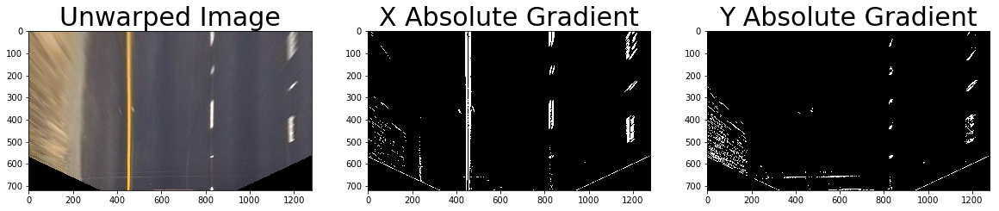

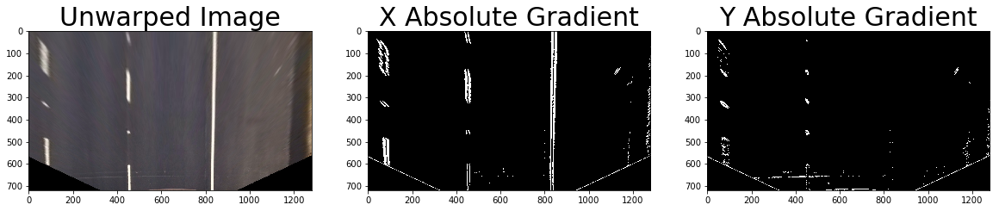

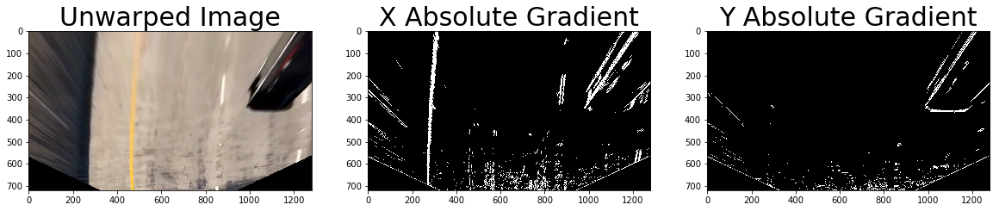

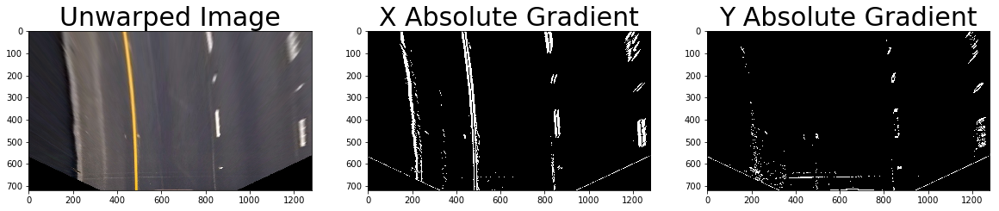

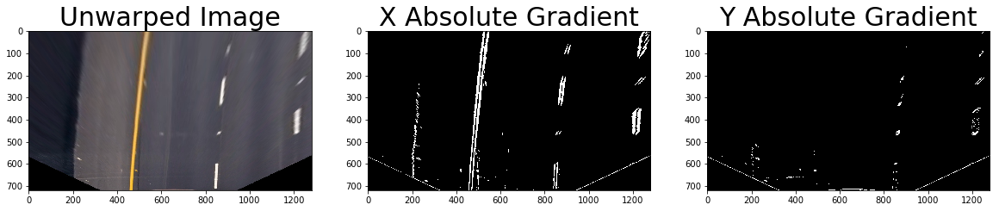

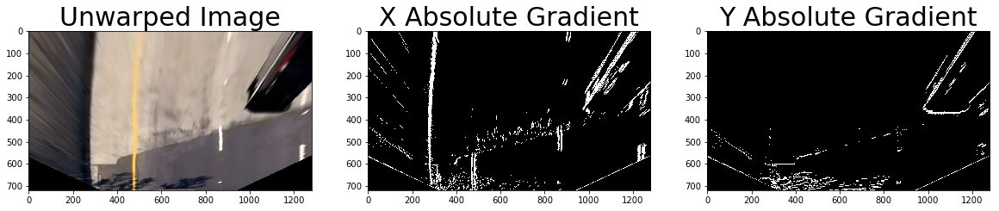

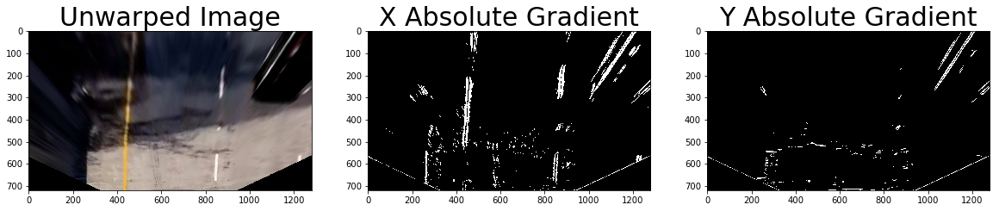

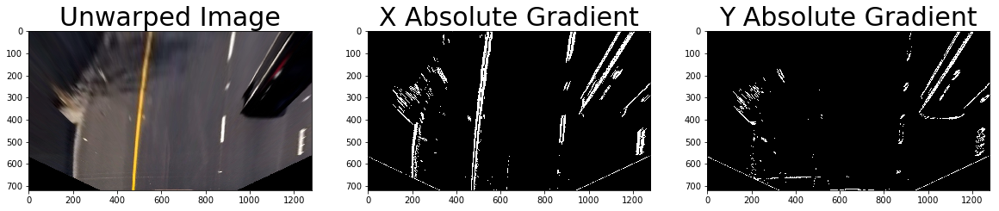

In [8]:
unwarped_test_images = glob.glob('./output_images/warp/*.jpg')

for idx, fname in enumerate(unwarped_test_images):
    # Run the Absolute Threshold function
    unwarp_image = cv2.imread(fname)
    grad_binary_x = abs_sobel_thresh(unwarp_image, orient='x', kernel_size=3, thresh=(15, 210))
    grad_binary_y = abs_sobel_thresh(unwarp_image, orient='y', kernel_size=3, thresh=(15, 210))
    # Plot the result
    f, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(20, 10))
    ax1.imshow(unwarp_image)
    ax1.set_title('Unwarped Image', fontsize=30)
    ax2.imshow(grad_binary_x, cmap='gray')
    ax2.set_title('X Absolute Gradient', fontsize=30)
    ax3.imshow(grad_binary_y, cmap='gray')
    ax3.set_title('Y Absolute Gradient', fontsize=30)

## Test Sobel Magnitude Threshold

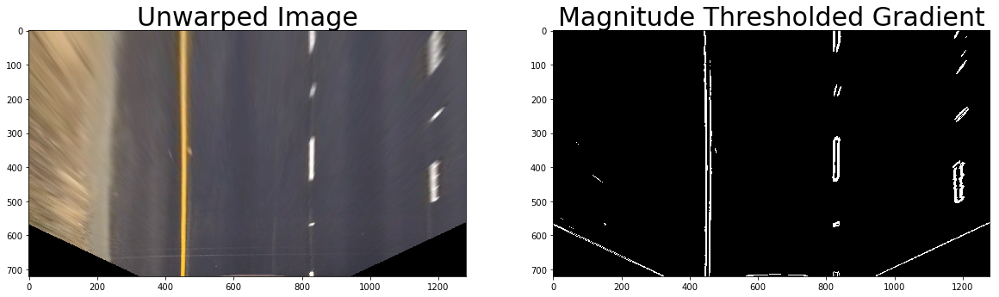

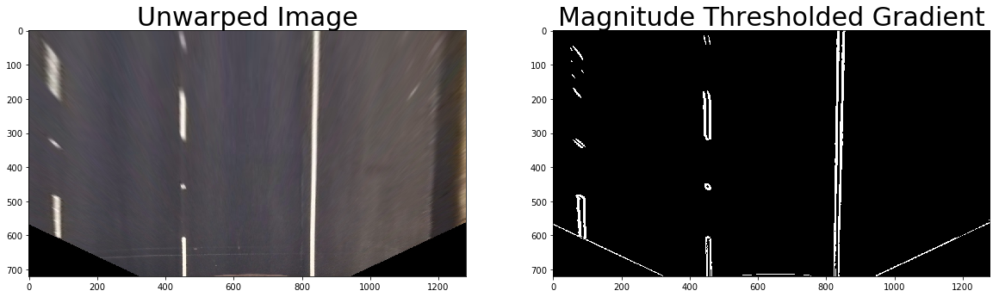

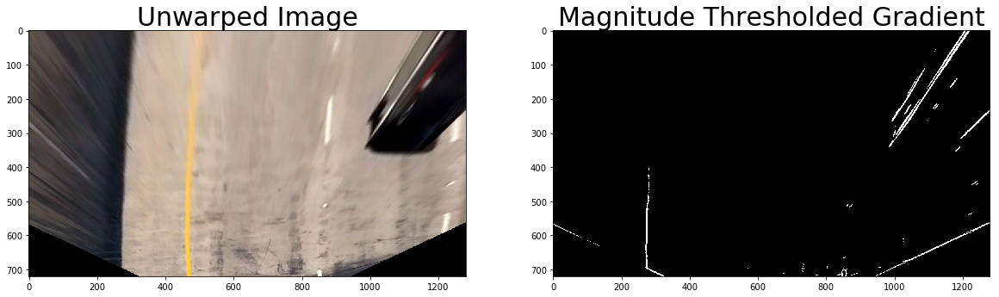

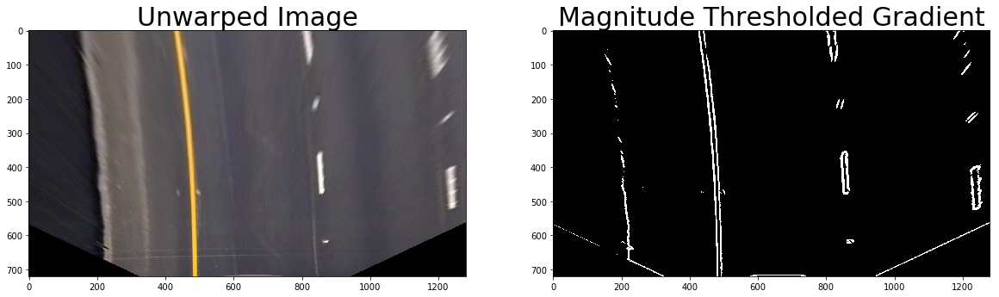

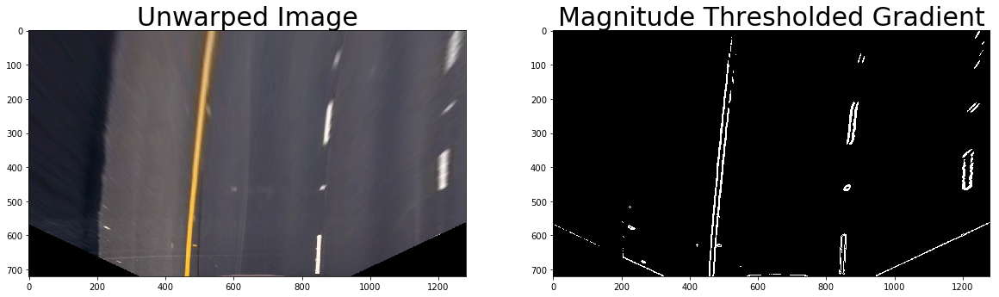

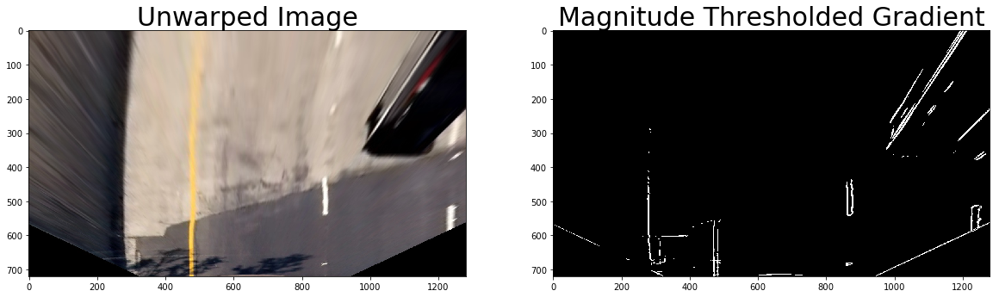

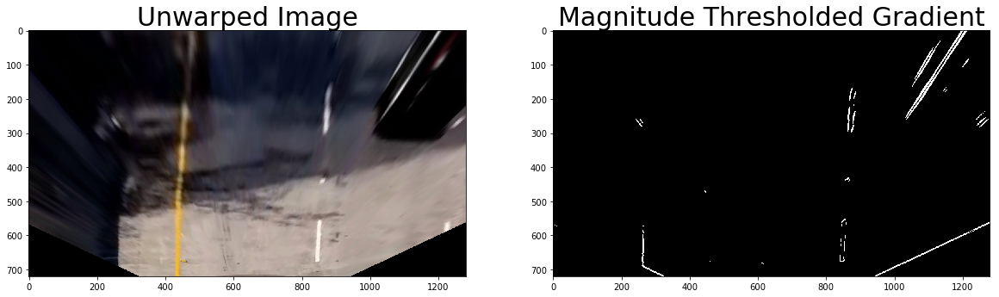

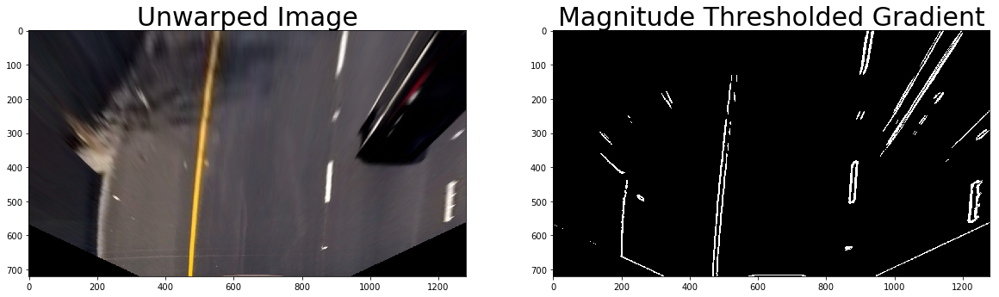

In [9]:
for idx, fname in enumerate(unwarped_test_images):
    # Run the Absolute Threshold function
    unwarp_image = cv2.imread(fname)
    mag_binary = mag_thresh(unwarp_image, kernel_size=9, mag_thresh=(50, 200))
    # Plot the result
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 10))
    ax1.imshow(unwarp_image)
    ax1.set_title('Unwarped Image', fontsize=30)
    ax2.imshow(mag_binary, cmap='gray')
    ax2.set_title('Magnitude Thresholded Gradient', fontsize=30)

## Test Direction Threshold

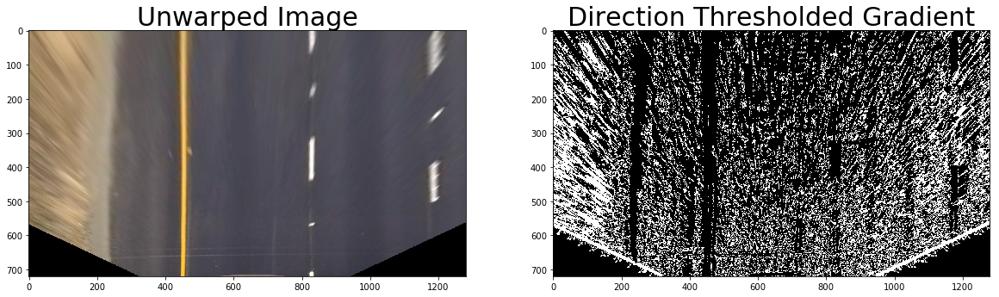

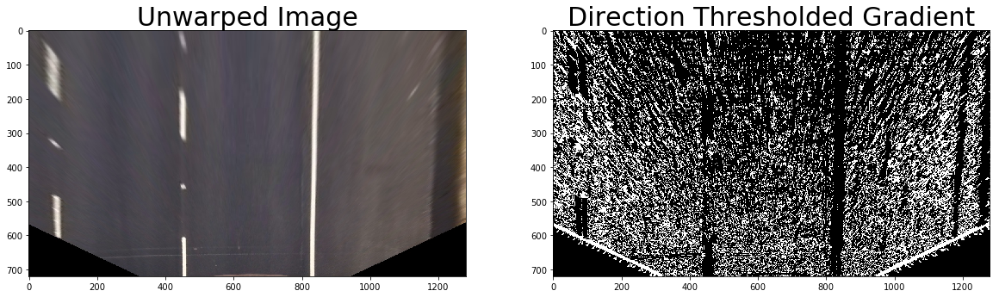

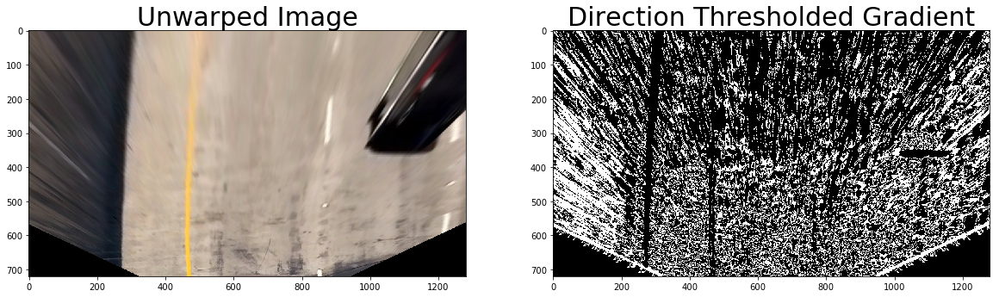

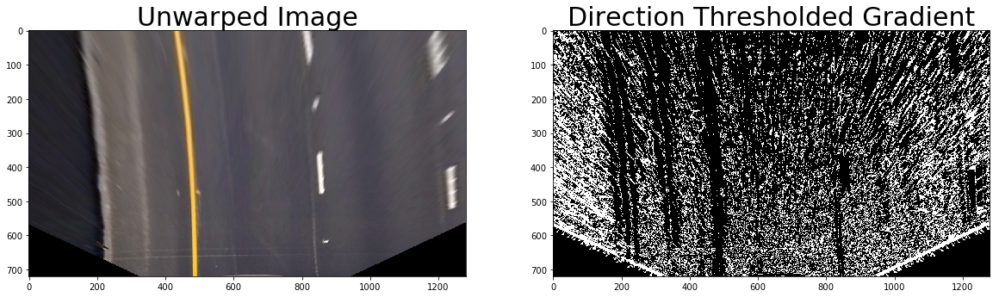

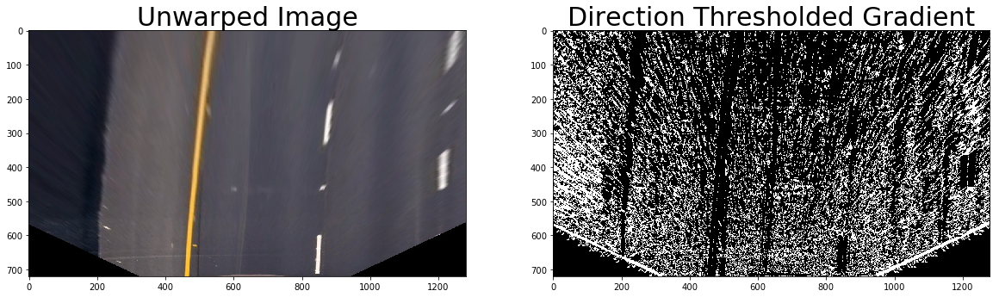

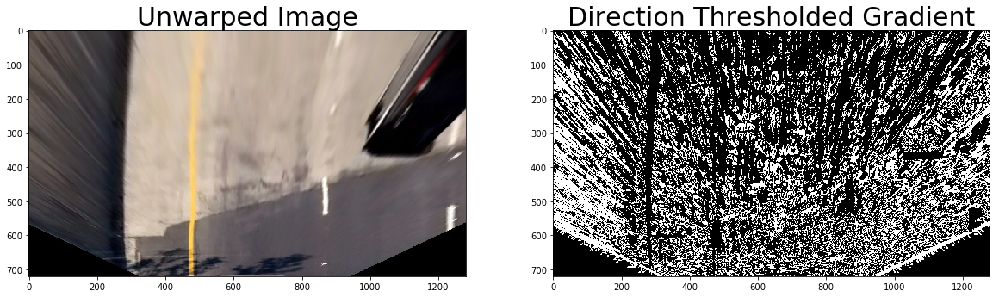

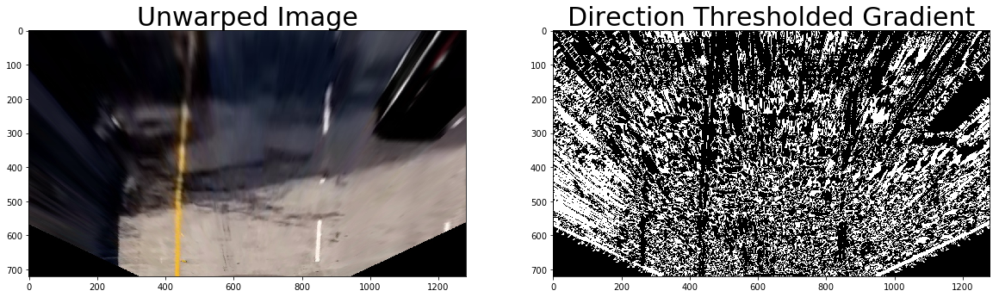

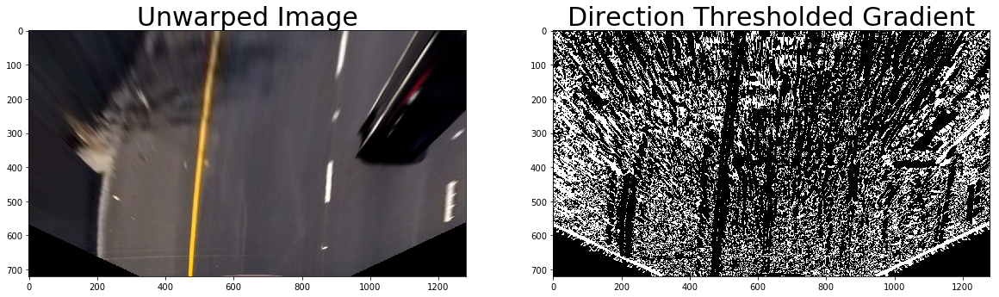

In [10]:
for idx, fname in enumerate(unwarped_test_images):
    # Run the Absolute Threshold function
    unwarp_image = cv2.imread(fname)
    dir_binary = dir_threshold(unwarp_image, kernel_size=15, thresh=(0.7, 1.3))
    # Plot the result
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 10))
    ax1.imshow(unwarp_image)
    ax1.set_title('Unwarped Image', fontsize=30)
    ax2.imshow(dir_binary, cmap='gray')
    ax2.set_title('Direction Thresholded Gradient', fontsize=30)

## Test Color S Channel Threshold

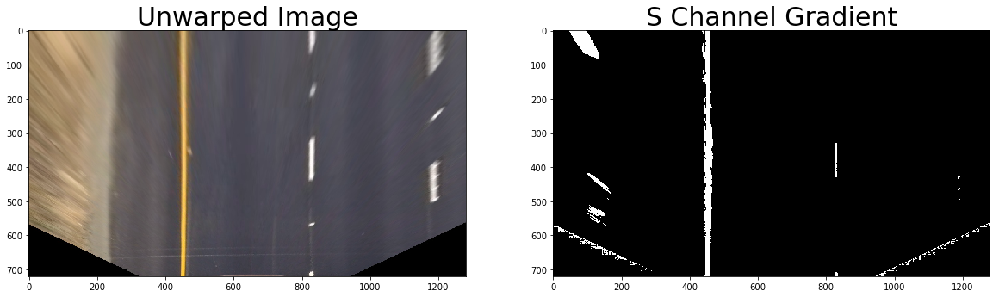

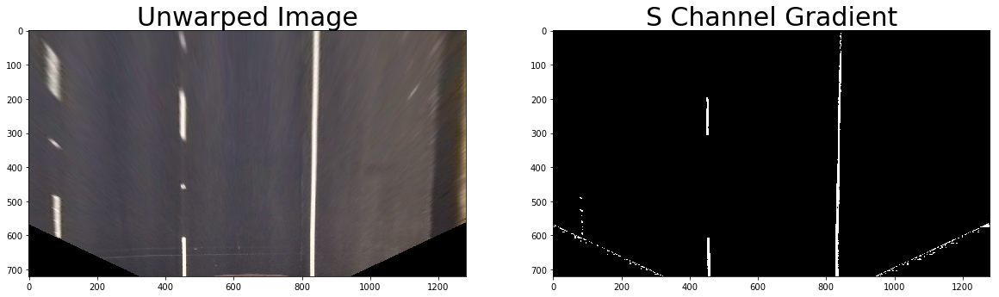

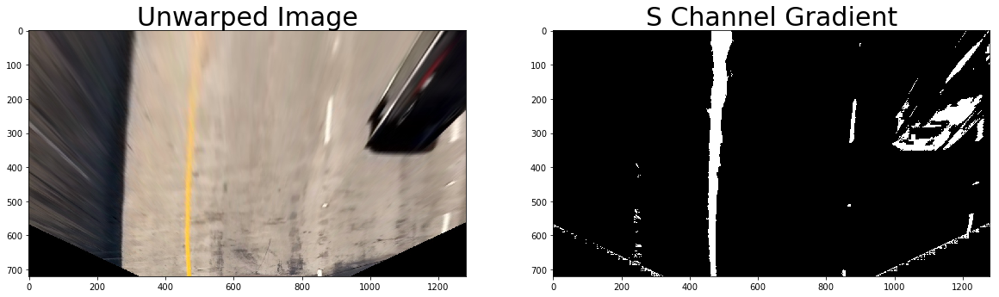

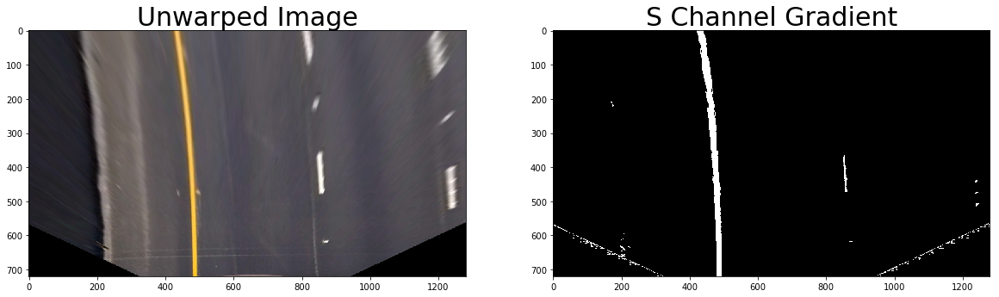

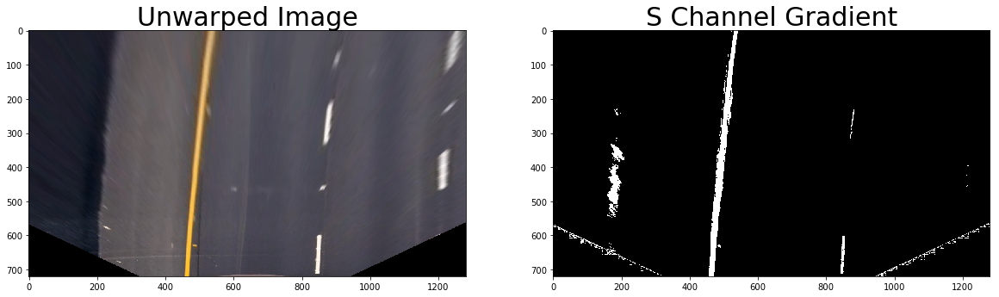

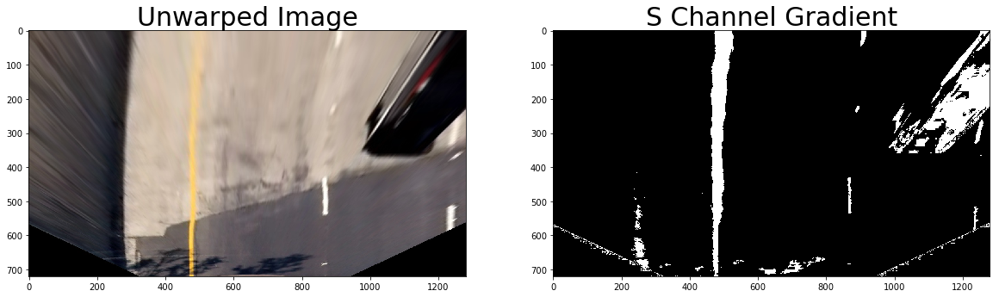

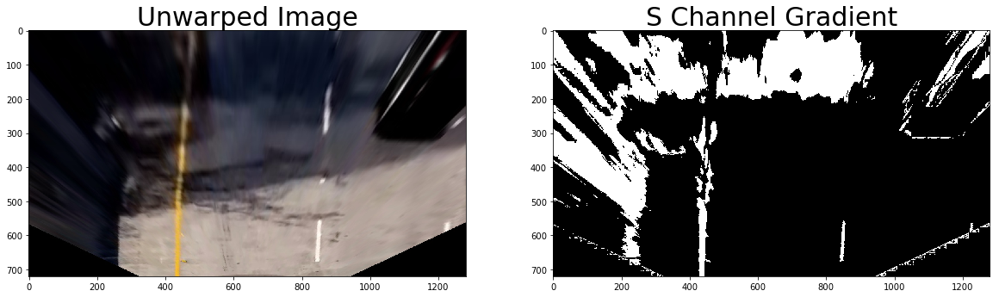

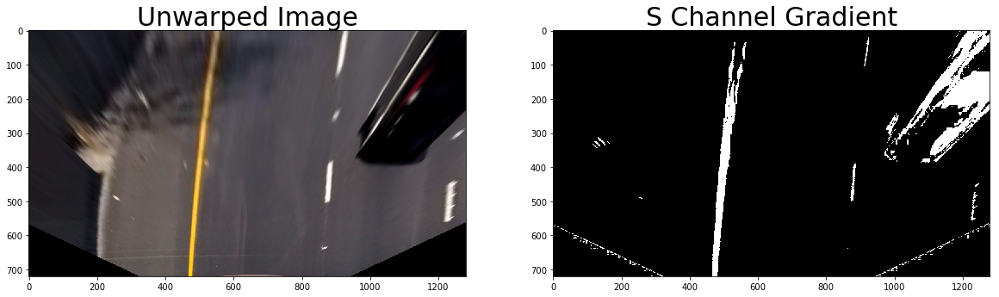

In [11]:
for idx, fname in enumerate(unwarped_test_images):
    # Run the Absolute Threshold function
    unwarp_image = cv2.imread(fname)
    hls_binary = hls_select(unwarp_image, thresh=(100, 255))
    # Plot the result
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 10))
    ax1.imshow(unwarp_image)
    ax1.set_title('Unwarped Image', fontsize=30)
    ax2.imshow(hls_binary, cmap='gray')
    ax2.set_title('S Channel Gradient', fontsize=30)

## Test Color B Channel Threshold

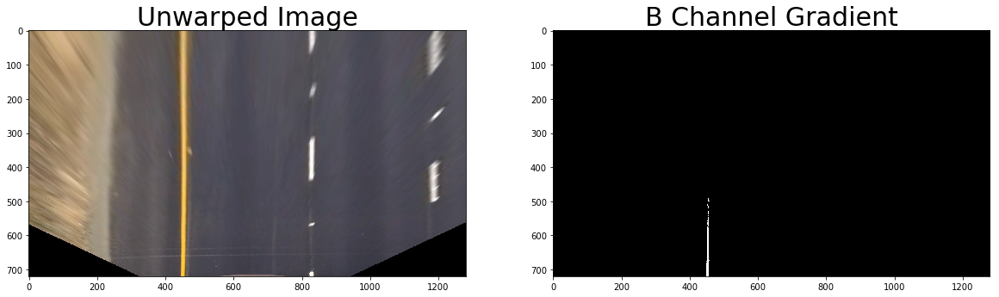

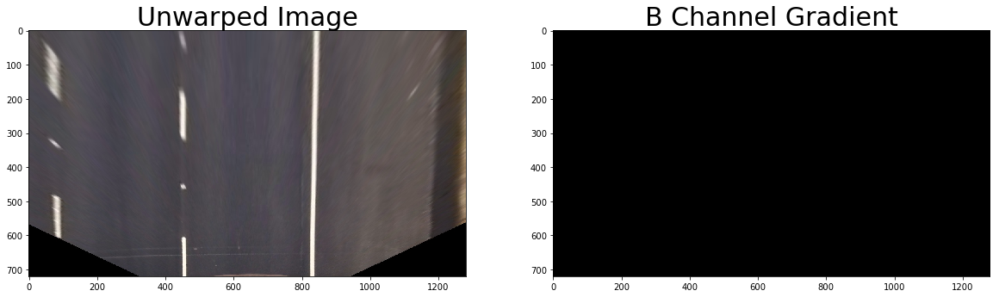

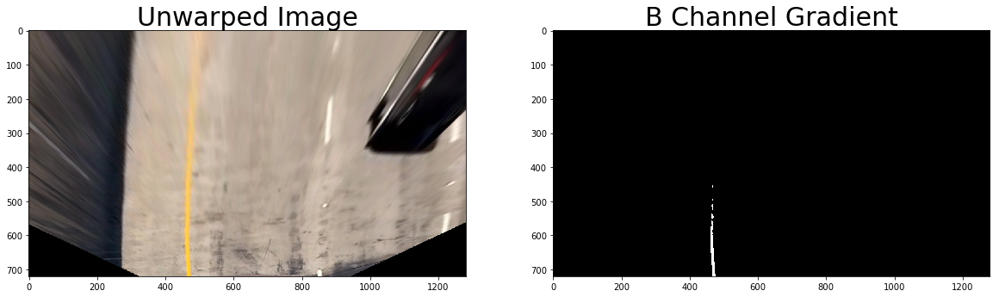

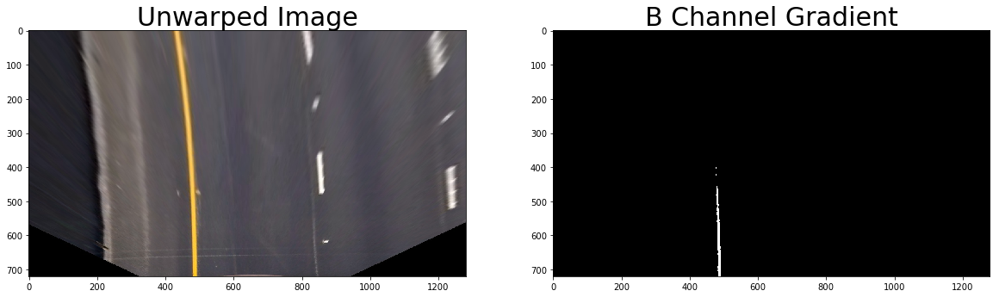

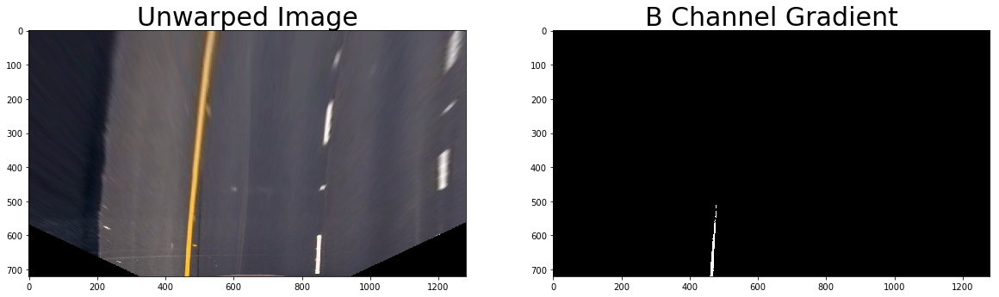

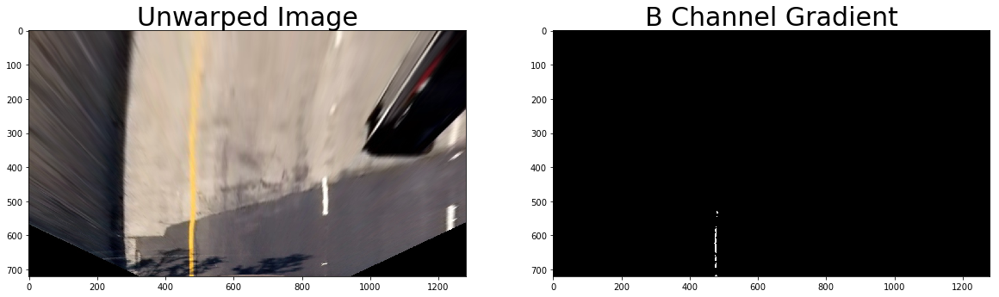

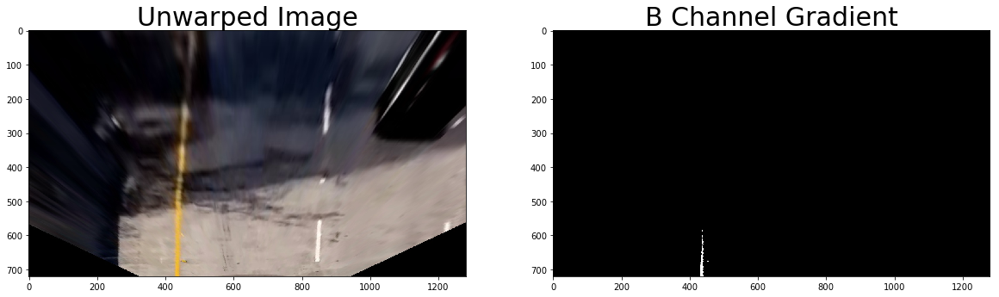

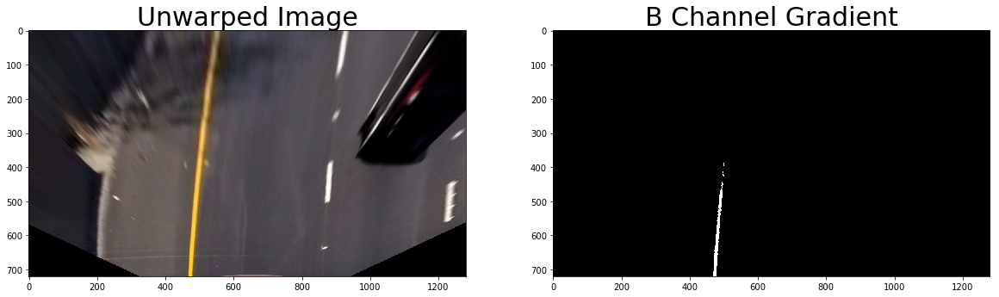

In [12]:
#Surprised to find that the B Channel covering Blue-Yellow in LAB color space detects yellow lanes very well after adjusting thresholds
for idx, fname in enumerate(unwarped_test_images):
    # Run the Absolute Threshold function
    unwarp_image = cv2.imread(fname)
    lab_binary = lab_select(unwarp_image, thresh=(190, 255))
    # Plot the result
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 10))
    ax1.imshow(unwarp_image)
    ax1.set_title('Unwarped Image', fontsize=30)
    ax2.imshow(lab_binary, cmap='gray')
    ax2.set_title('B Channel Gradient', fontsize=30)

## Test Combined Binary Image Results

In [13]:
def combined(image):
    ksize = 3
    s_thresh = hls_select(image, thresh=(100, 255))
    b_thresh = lab_select(image, thresh=(190, 255))

    gradx = abs_sobel_thresh(image, orient='x', kernel_size=ksize, thresh=(15, 210))
    grady = abs_sobel_thresh(image, orient='y', kernel_size=ksize, thresh=(15, 210))
    dir_binary = dir_threshold(image, kernel_size=15, thresh=(0.7, 1.2))
    mag_binary = mag_thresh(image, kernel_size=9, mag_thresh=(50, 200))
    #combined = np.dstack((np.zeros_like(dir_binary), mag_binary, grady, gradx, s_thresh, b_thresh))
    combined = np.zeros_like(dir_binary)
    combined[((gradx == 1) & (grady == 1)) | ((mag_binary == 1) & (dir_binary == 1)) | (s_thresh == 1) | (b_thresh == 1)] = 1
    return combined

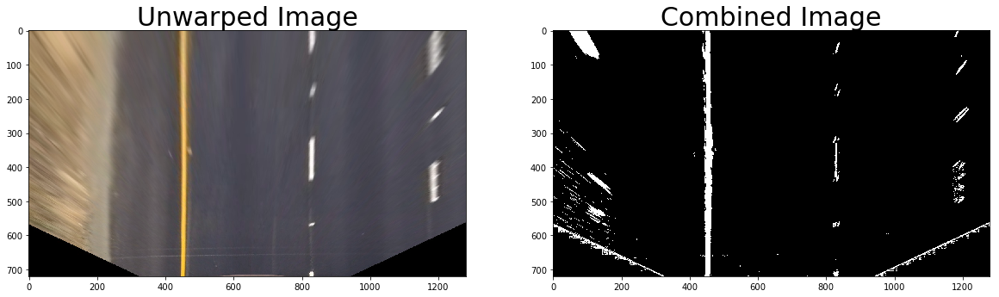

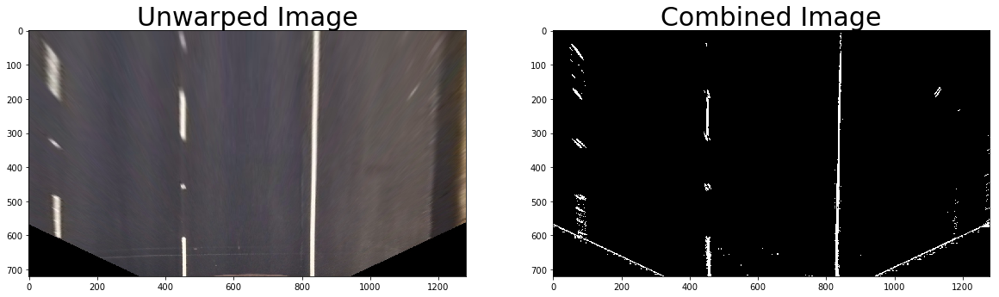

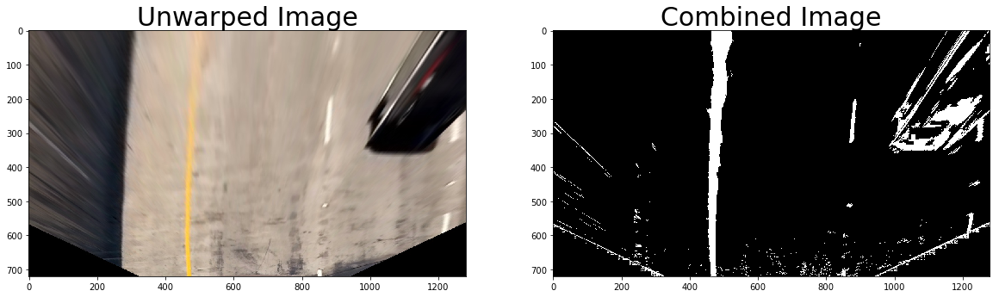

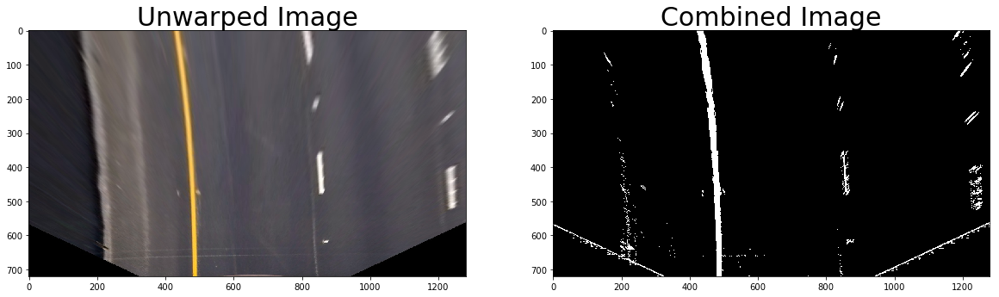

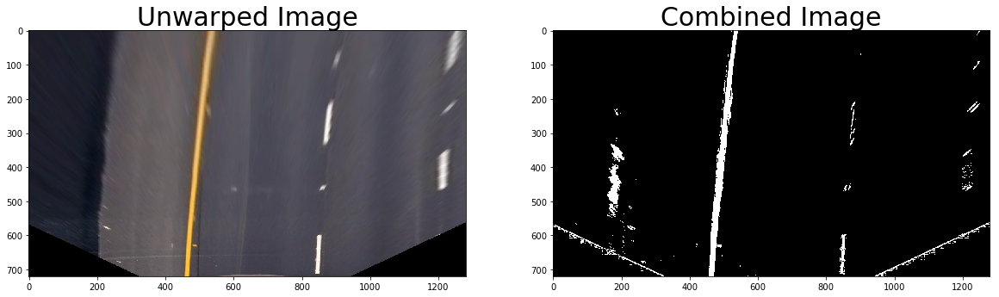

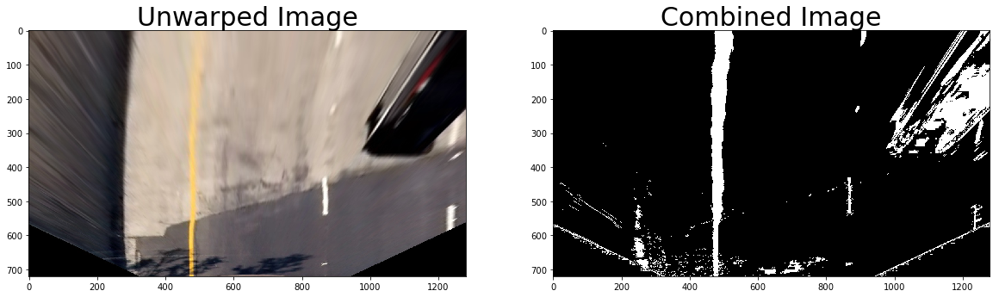

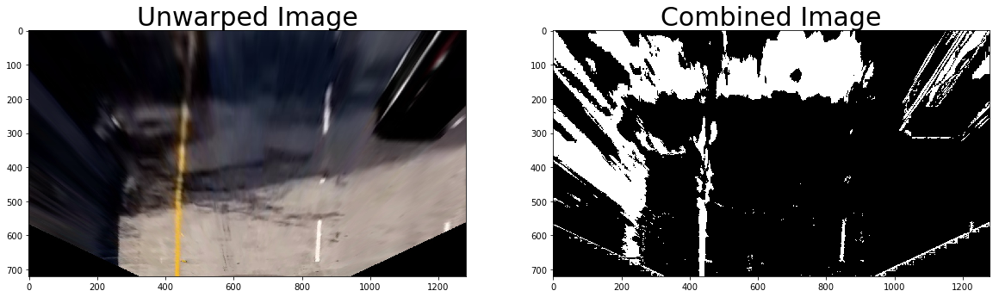

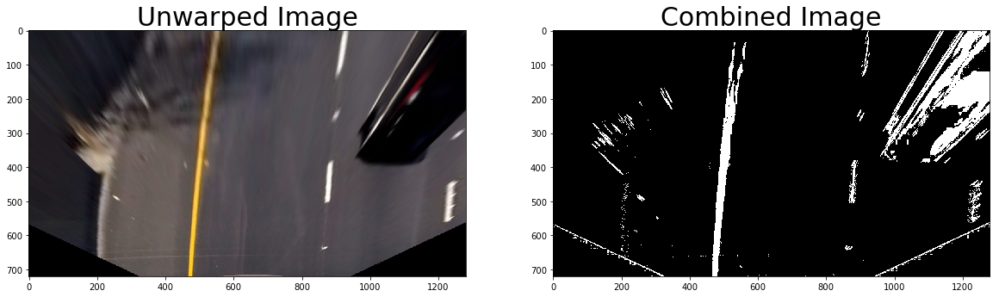

In [14]:
for idx, fname in enumerate(unwarped_test_images):
    # Run the Absolute Threshold function
    unwarp_image = cv2.imread(fname)
    combined_binary = combined(unwarp_image)
    # Plot the result
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 10))
    ax1.imshow(unwarp_image)
    ax1.set_title('Unwarped Image', fontsize=30)
    ax2.imshow(combined_binary, cmap='gray')
    ax2.set_title('Combined Image', fontsize=30)

## Pipeline Test - Putting it all together - Undistort, Unwarp and Combined Threshold Images

./test_images/straight_lines1.jpg
./test_images/straight_lines2.jpg
./test_images/test1.jpg
./test_images/test2.jpg
./test_images/test3.jpg
./test_images/test4.jpg
./test_images/test5.jpg
./test_images/test6.jpg


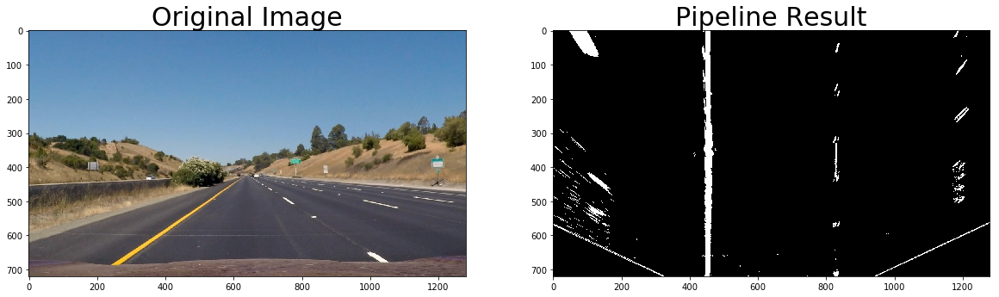

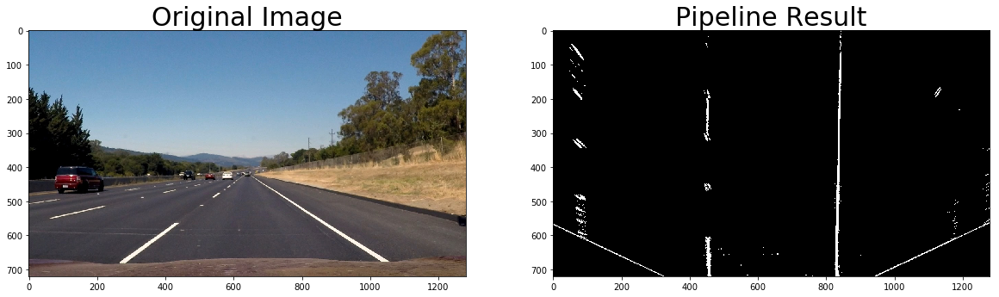

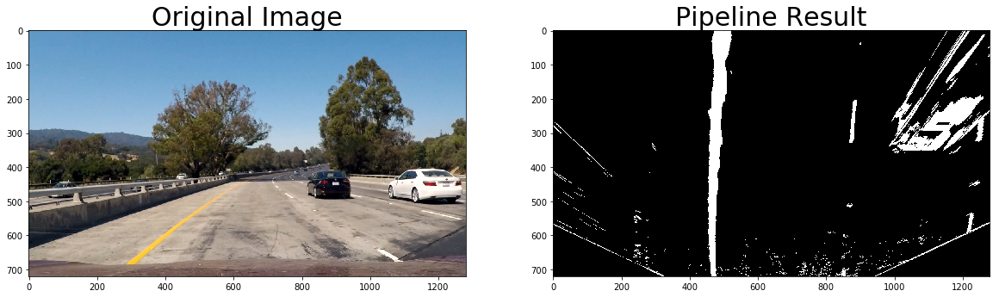

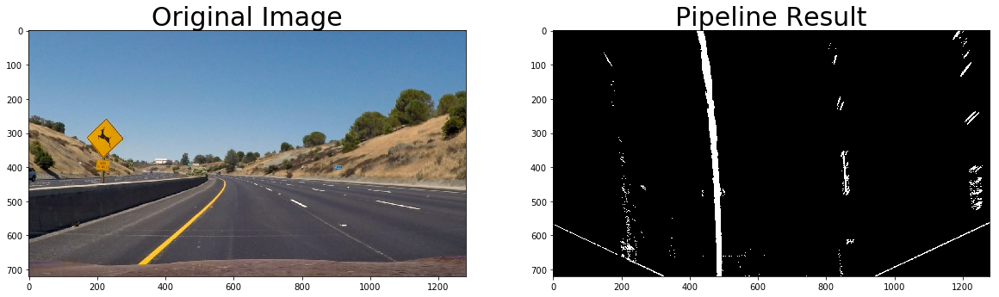

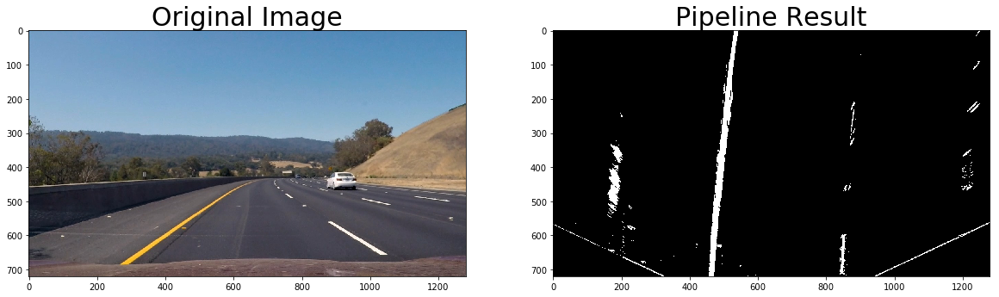

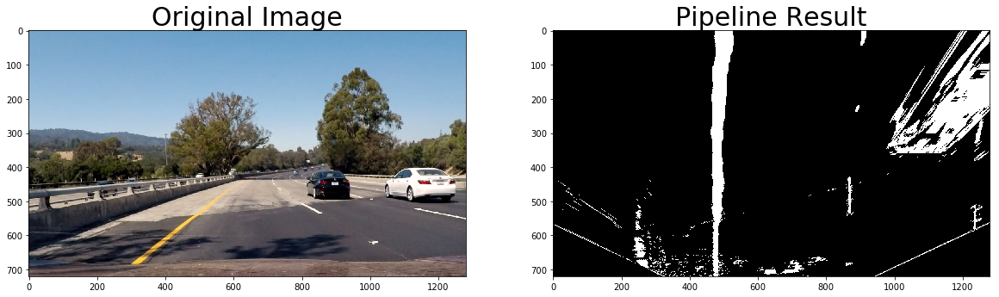

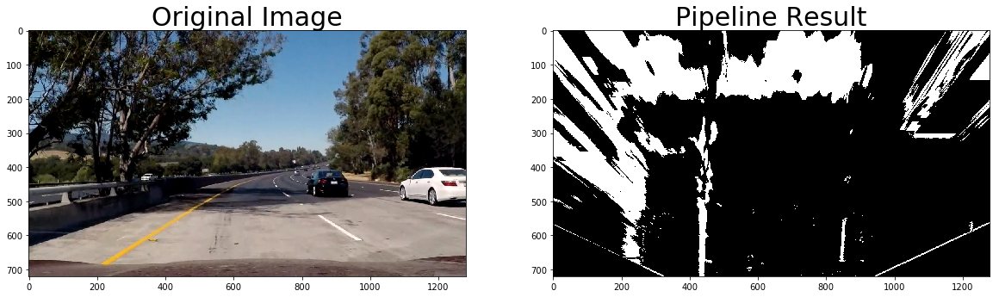

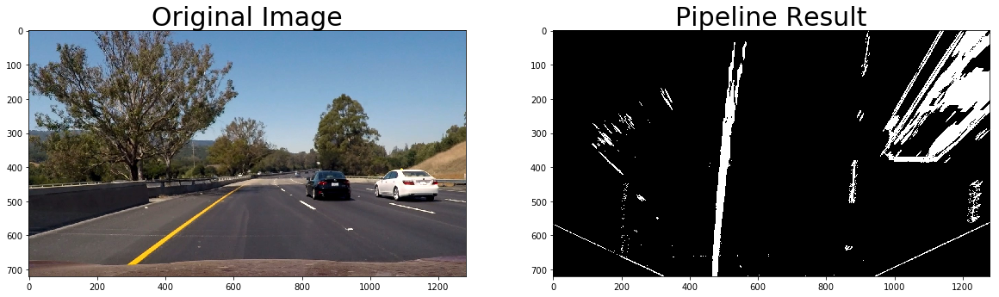

In [61]:
def pipeline(input_image):
    #img = undistort_image(input_image)
    img = undistort(input_image)
    img, M, Minv = unwarp(img, src, dst)
    img = combined(img)
    return img

# Make a list of example images
starting_test_images = glob.glob('./test_images/*.jpg')

for idx, fname in enumerate(starting_test_images):
    # Run the Absolute Threshold function
    print(fname)
    input_image = cv2.imread(fname)
    input_image = cv2.cvtColor(input_image, cv2.COLOR_BGR2RGB)
    result = pipeline(input_image)
    # Plot the result
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 10))
    ax1.imshow(input_image)
    ax1.set_title('Original Image', fontsize=30)
    ax2.imshow(result, cmap='gray')
    ax2.set_title('Pipeline Result', fontsize=30)

## Step 8 Draw Histogram to identify lanes and Fit Polynomial to Sliding Windows

In [62]:
# Define method to fit polynomial AX**2+BX+C to binary image with lines extracted, using sliding window
def orchestrate_sliding_windows(img):
    # Take a histogram of the bottom half of the image
    histogram = np.sum(img[img.shape[0]//2:,:], axis=0)
    # Find the peak of the left and right halves of the histogram
    # These will be the starting point for the left and right lines
    midpoint = np.int(histogram.shape[0]//2)
    quarter_point = np.int(midpoint//2)
    # Previously the left/right base was the max of the left/right half of the histogram
    # this changes it so that only a quarter of the histogram (directly to the left/right) is considered
    leftx_base = np.argmax(histogram[quarter_point:midpoint]) + quarter_point
    rightx_base = np.argmax(histogram[midpoint:(midpoint+quarter_point)]) + midpoint
    
    #print('base pts:', leftx_base, rightx_base)

    # Choose the number of sliding windows
    nwindows = 10
    # Set height of windows
    window_height = np.int(img.shape[0]/nwindows)
    # Identify the x and y positions of all nonzero pixels in the image
    nonzero = img.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    # Current positions to be updated for each window
    leftx_current = leftx_base
    rightx_current = rightx_base
    # Set the width of the windows +/- margin
    margin = 80
    # Set minimum number of pixels found to recenter window
    minpix = 40
    # Create empty lists to receive left and right lane pixel indices
    left_lane_inds = []
    right_lane_inds = []
    # Rectangle data for visualization
    rectangle_data = []

    # Step through the windows one by one
    for window in range(nwindows):
        # Identify window boundaries in x and y (and right and left)
        win_y_low = img.shape[0] - (window+1)*window_height
        win_y_high = img.shape[0] - window*window_height
        win_xleft_low = leftx_current - margin
        win_xleft_high = leftx_current + margin
        win_xright_low = rightx_current - margin
        win_xright_high = rightx_current + margin
        rectangle_data.append((win_y_low, win_y_high, win_xleft_low, win_xleft_high, win_xright_low, win_xright_high))
        # Identify the nonzero pixels in x and y within the window
        good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & (nonzerox >= win_xleft_low) & (nonzerox < win_xleft_high)).nonzero()[0]
        good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & (nonzerox >= win_xright_low) & (nonzerox < win_xright_high)).nonzero()[0]
        # Append these indices to the lists
        left_lane_inds.append(good_left_inds)
        right_lane_inds.append(good_right_inds)
        # If you found > minpix pixels, recenter next window on their mean position
        if len(good_left_inds) > minpix:
            leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
        if len(good_right_inds) > minpix:        
            rightx_current = np.int(np.mean(nonzerox[good_right_inds]))

    # Concatenate the arrays of indices
    left_lane_inds = np.concatenate(left_lane_inds)
    right_lane_inds = np.concatenate(right_lane_inds)

    # Extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds] 

    left_fit, right_fit = (None, None)
    # Fit a second order polynomial to each
    if len(leftx) != 0:
        left_fit = np.polyfit(lefty, leftx, 2)
    if len(rightx) != 0:
        right_fit = np.polyfit(righty, rightx, 2)
    
    visualization_data = (rectangle_data, histogram)
    
    return left_fit, right_fit, left_lane_inds, right_lane_inds, visualization_data

### Test Sliding Window Orchestration and Polyomial Fit with All Test Images

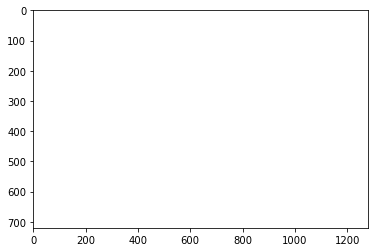

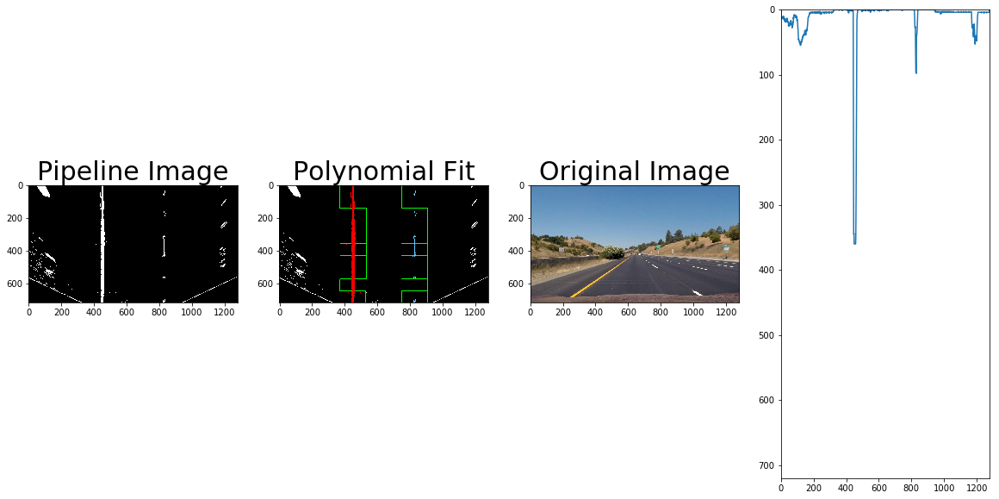

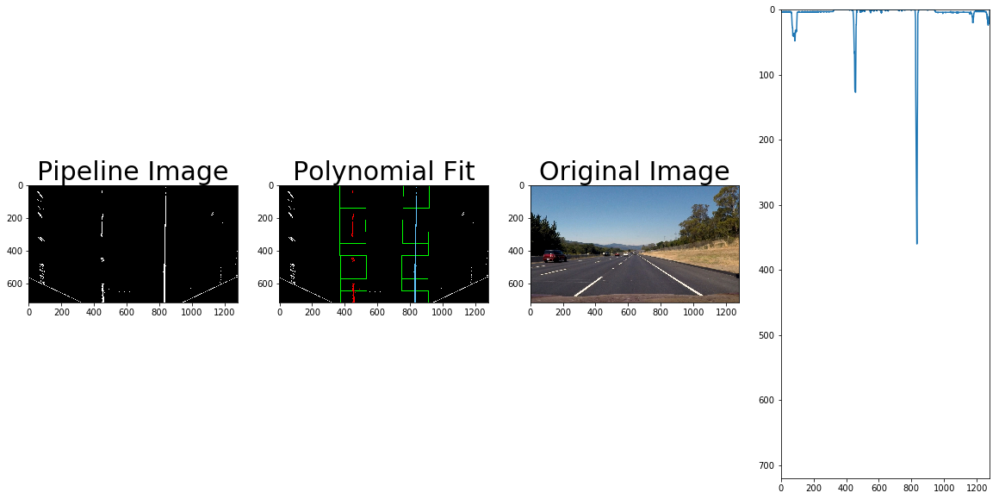

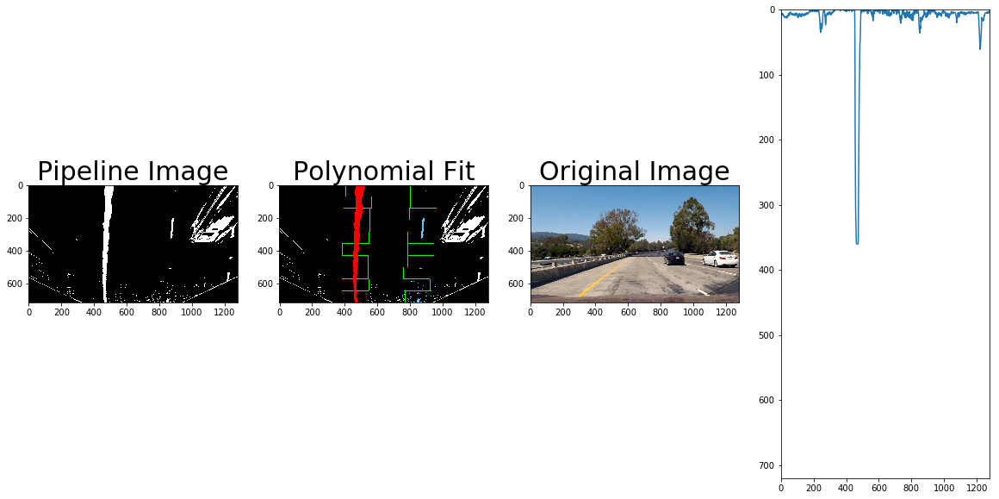

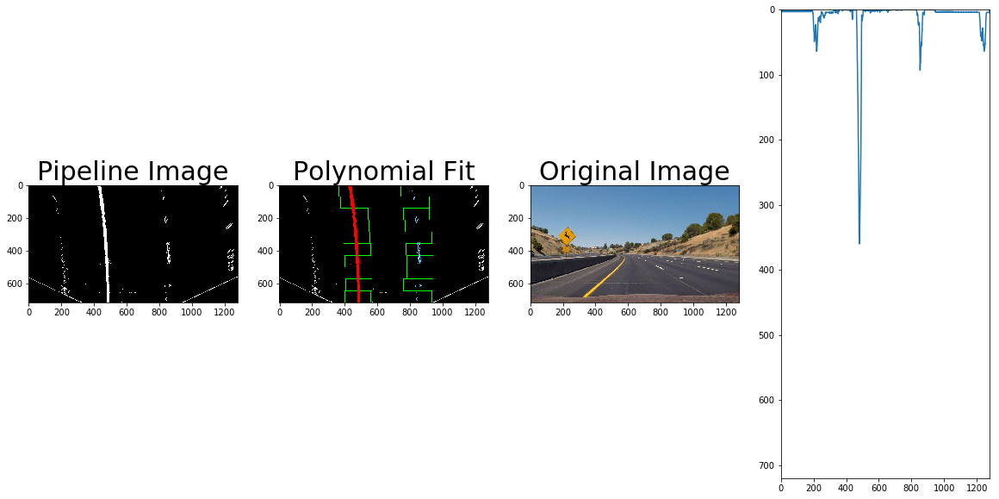

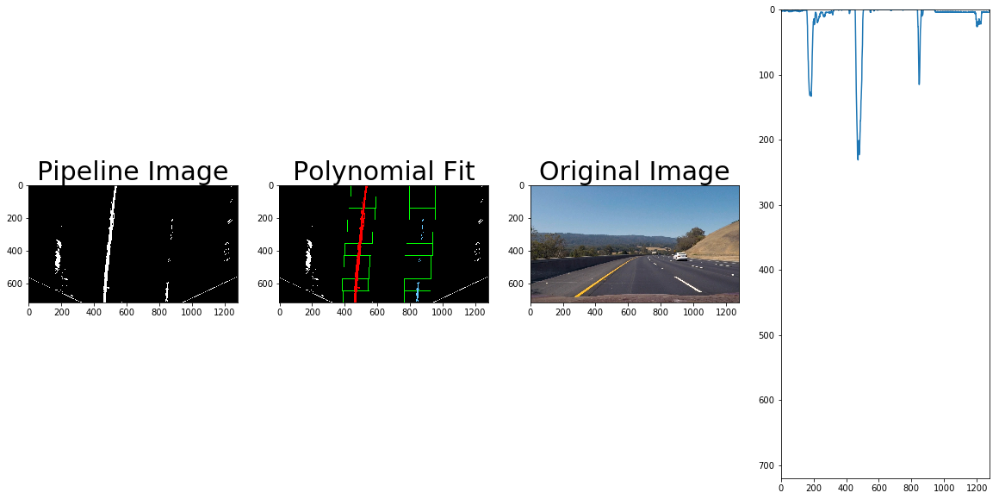

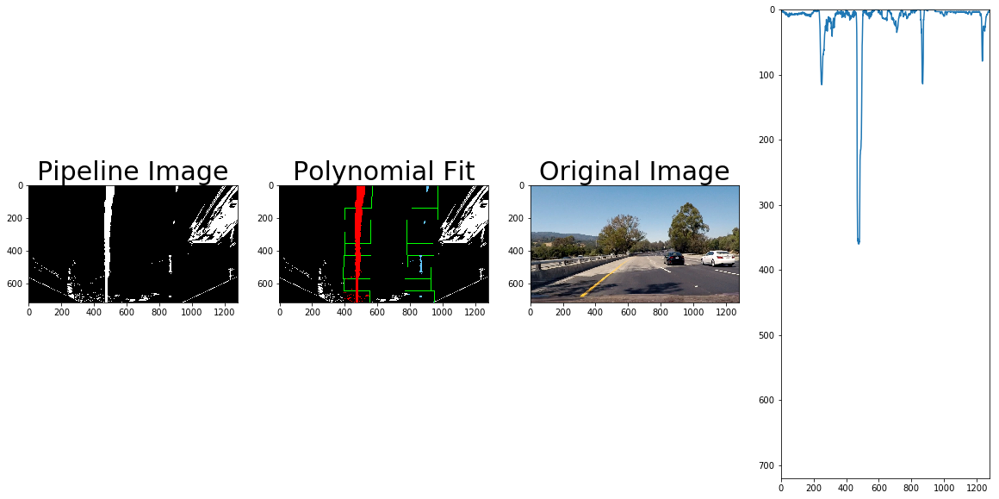

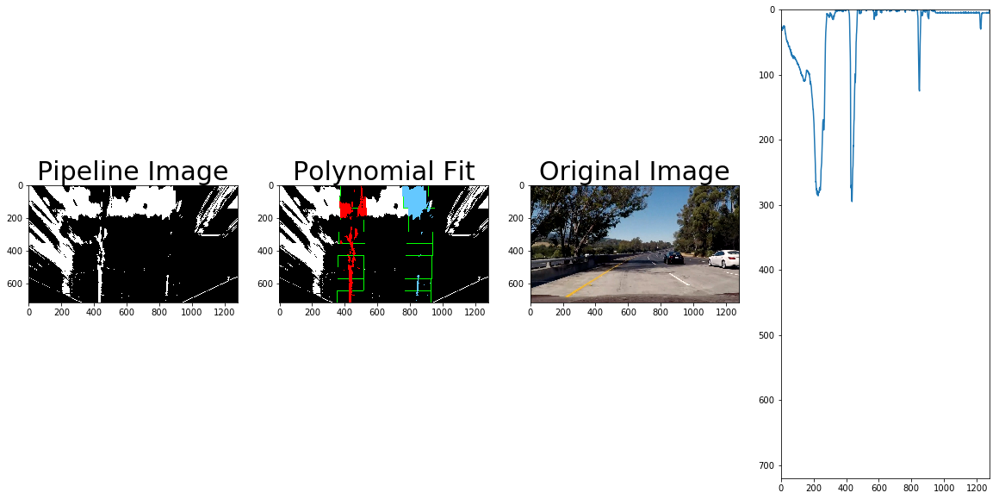

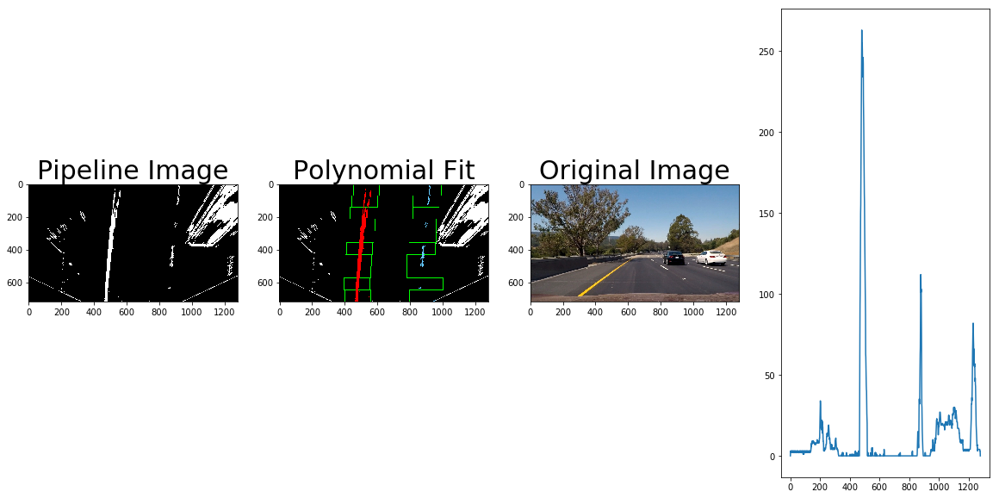

In [63]:
for idx, fname in enumerate(starting_test_images):
    # Run the Absolute Threshold function
    input_image = cv2.imread(fname)
    input_image = cv2.cvtColor(input_image, cv2.COLOR_BGR2RGB)
    result = pipeline(input_image)
    left_fit, right_fit, left_lane_inds, right_lane_inds, visualization_data = orchestrate_sliding_windows(result)
    h, w = result.shape[1], result.shape[0]
    
    #Fit X-intercepts
    left_fit_x_int = left_fit[0]*h**2 + left_fit[1]*h + left_fit[2]
    right_fit_x_int = right_fit[0]*h**2 + right_fit[1]*h + right_fit[2]
    
    rectangles = visualization_data[0]
    histogram = visualization_data[1]
    
    # Create an output image to draw on and  visualize the result
    out_img = np.uint8(np.dstack((result, result, result))*255)
    
    # Generate x and y values for plotting
    ploty = np.linspace(0, result.shape[0]-1, result.shape[0] )
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]

    # Draw the rectangle windows on the visualization image    
    for rect in rectangles:
        cv2.rectangle(out_img,(rect[2],rect[0]),(rect[3],rect[1]),(0,255,0), 2) 
        cv2.rectangle(out_img,(rect[4],rect[0]),(rect[5],rect[1]),(0,255,0), 2) 
    
    # Identify the x and y positions of all nonzero pixels in the image
    nonzero = result.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    out_img[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] = [255, 0, 0]
    out_img[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] = [100, 200, 255]
    plt.xlim(0, 1280)
    plt.ylim(720, 0)
    
    f, (ax1, ax2, ax3, ax4) = plt.subplots(1, 4, figsize=(20, 10))
    ax1.imshow(result, cmap='gray')
    ax1.set_title('Pipeline Image', fontsize=30)
    ax2.imshow(out_img, cmap='gray')
    ax2.set_title('Polynomial Fit', fontsize=30)
    ax3.imshow(input_image, cmap='gray')
    ax3.set_title('Original Image', fontsize=30)
    plt.plot(histogram)

## Radius of Curvature, Lane Width and Positioning

In [64]:
# Determine Radius of Curves and lane centroid
def radius_of_curvature(binary_image, l_fit, r_fit, l_lane_inds, r_lane_inds):
    # Define conversions in x and y from pixels space to meters
    ym_per_pix = 3.048/100 # meters per pixel in y dimension, lane line is 10 ft = 3.048 meters
    xm_per_pix = 3.7/378 # meters per pixel in x dimension, lane width is 12 ft = 3.7 meters
    left_curverad, right_curverad, center_dist = (0, 0, 0)
    # Define y-value where we want radius of curvature
    # I'll choose the maximum y-value, corresponding to the bottom of the image
    h = binary_image.shape[0]
    ploty = np.linspace(0, h-1, h)
    y_eval = np.max(ploty)
  
    # Identify the x and y positions of all nonzero pixels in the image
    nonzero = binary_image.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    # Again, extract left and right line pixel positions
    leftx = nonzerox[l_lane_inds]
    lefty = nonzeroy[l_lane_inds] 
    rightx = nonzerox[r_lane_inds]
    righty = nonzeroy[r_lane_inds]
    
    if len(leftx) != 0 and len(rightx) != 0:
        # Fit new polynomials to x,y in world space
        left_fit_cr = np.polyfit(lefty*ym_per_pix, leftx*xm_per_pix, 2)
        right_fit_cr = np.polyfit(righty*ym_per_pix, rightx*xm_per_pix, 2)
        # Calculate the new radii of curvature
        left_curverad = ((1 + (2*left_fit_cr[0]*y_eval*ym_per_pix + left_fit_cr[1])**2)**1.5) / np.absolute(2*left_fit_cr[0])
        right_curverad = ((1 + (2*right_fit_cr[0]*y_eval*ym_per_pix + right_fit_cr[1])**2)**1.5) / np.absolute(2*right_fit_cr[0])
        # Now our radius of curvature is in meters
    
    # Distance from center is image x midpoint - mean of l_fit and r_fit intercepts 
    if r_fit is not None and l_fit is not None:
        car_position = binary_image.shape[1]/2
        l_fit_x_int = l_fit[0]*h**2 + l_fit[1]*h + l_fit[2]
        r_fit_x_int = r_fit[0]*h**2 + r_fit[1]*h + r_fit[2]
        lane_center_position = (r_fit_x_int + l_fit_x_int) /2
        center_dist = (car_position - lane_center_position) * xm_per_pix
    return left_curverad, right_curverad, center_dist

In [65]:
#Test Radius of curvature
for idx, fname in enumerate(starting_test_images):
    # Run the Absolute Threshold function
    input_image = cv2.imread(fname)
    result = pipeline(input_image)
    left_fit, right_fit, left_lane_inds, right_lane_inds, visualization_data = orchestrate_sliding_windows(result)
    left_curve, right_curve, center = radius_of_curvature(result, left_fit, right_fit, left_lane_inds, right_lane_inds)
    print("For Image"+str(idx)+" "+"Left Curve:"+str(left_curve)+" "+"Right Curve:"+str(right_curve)+" "+"Center:"+str(center))

For Image0 Left Curve:1774.68978283 Right Curve:3032.18007954 Center:-0.000933369637803
For Image1 Left Curve:1573.52404012 Right Curve:8181.06241794 Center:-0.0331386165264
For Image2 Left Curve:646.625720086 Right Curve:132089.040705 Center:-0.135546208347
For Image3 Left Curve:512.246171692 Right Curve:235.433937407 Center:-0.270935147363
For Image4 Left Curve:1424.59539355 Right Curve:1364.70841808 Center:-0.129764580568
For Image5 Left Curve:711.009875971 Right Curve:1851.7226339 Center:-0.217878321439
For Image6 Left Curve:225.511183948 Right Curve:269.370948571 Center:-0.0660469447721
For Image7 Left Curve:537.075701247 Right Curve:227.232597968 Center:-0.401717093451


In [66]:
def draw_lane_polygon(original_image, pipeline_image, left_fit, right_fit, Minv):
    image_copy = np.copy(original_image)
    if left_fit == None or right_fit == None:
        return original_image
    #Create a new painted image
    warp_zero = np.zeros_like(pipeline_image).astype(np.uint8)
    color_warp = np.dstack((warp_zero, warp_zero, warp_zero))
    
    h,w = pipeline_image.shape[:2]
    ploty = np.linspace(0, h-1, num=h)
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    
    # Recast the x and y points into usable format for cv2.fillPoly()
    left_vertices = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
    right_vertices = np.array([np.flipud(np.transpose(np.vstack([right_fitx, ploty])))])
    vertices = np.hstack((left_vertices, right_vertices))    
                        
    # Draw the lane onto the warped blank image
    cv2.fillPoly(color_warp, np.int_([vertices]), (0, 255, 0))
    cv2.polylines(color_warp, np.int32([left_vertices]), isClosed=False, color=(255,0,255), thickness=15)
    cv2.polylines(color_warp, np.int32([right_vertices]), isClosed=False, color=(0,255,255), thickness=15)
    
    # Warp the blank back to original image space using inverse perspective matrix (Minv)
    reverse_unwarp = cv2.warpPerspective(color_warp, Minv, (w, h)) 
    # Combine the result with the original image
    final_image = cv2.addWeighted(image_copy, 1, reverse_unwarp, 0.5, 0)
    return final_image


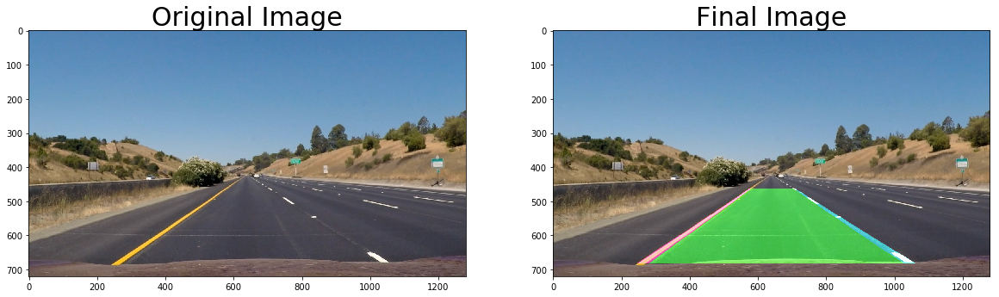

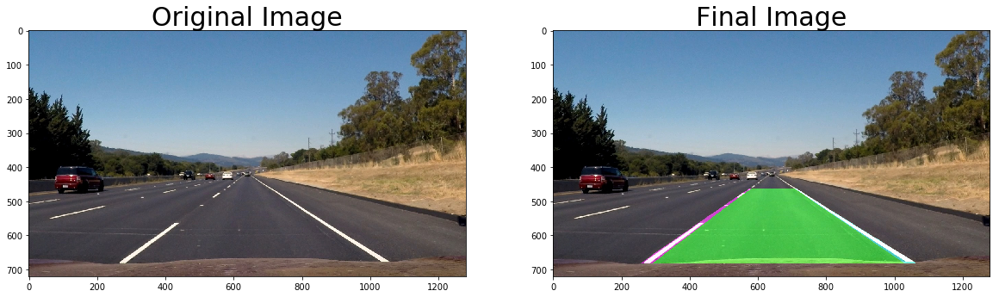

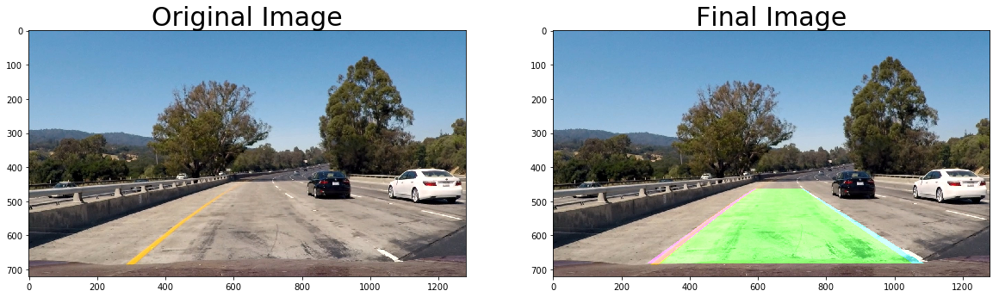

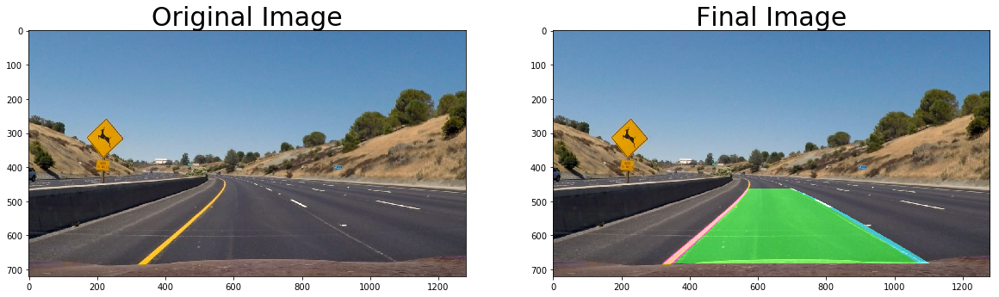

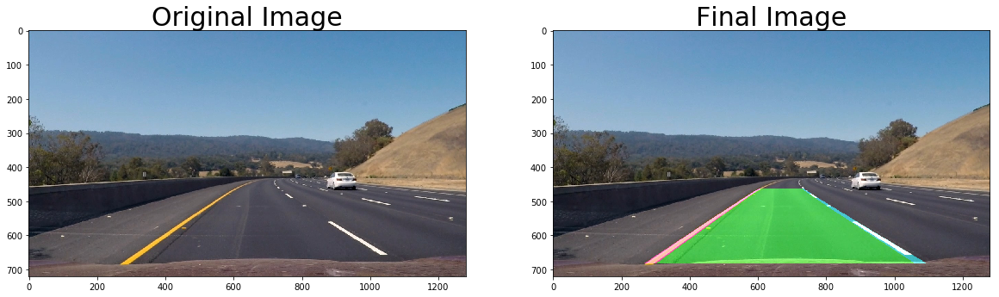

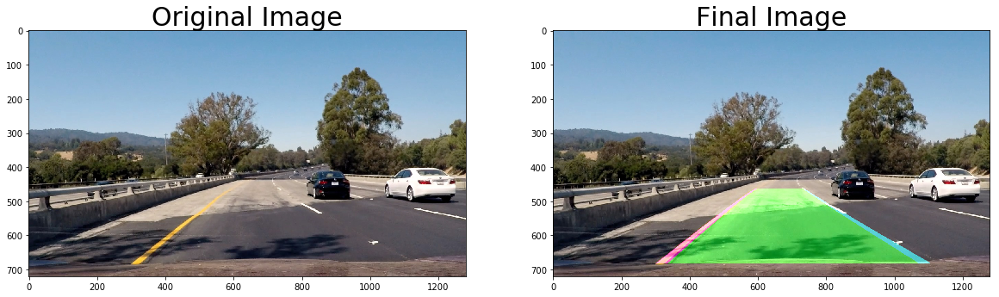

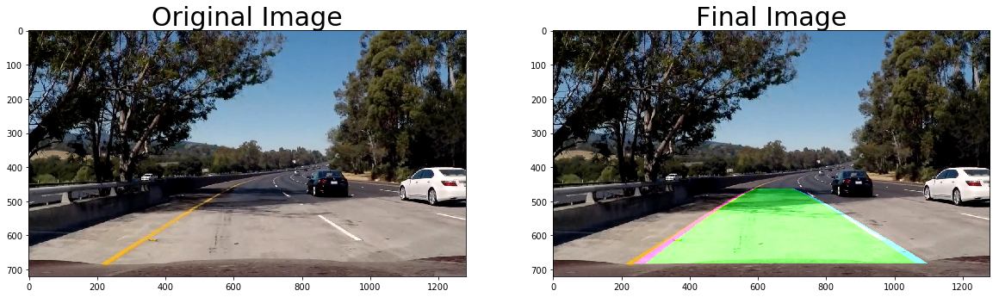

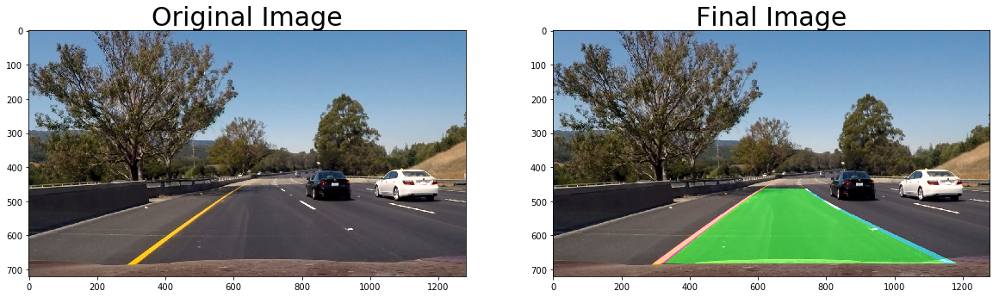

In [67]:
#Test Radius of curvature
for idx, fname in enumerate(starting_test_images):
    # Run the Absolute Threshold function
    input_image = cv2.imread(fname)
    input_image = cv2.cvtColor(input_image, cv2.COLOR_BGR2RGB)
    result = pipeline(input_image)
    left_fit, right_fit, left_lane_inds, right_lane_inds, visualization_data = orchestrate_sliding_windows(result)
    left_curve, right_curve, center = radius_of_curvature(result, left_fit, right_fit, left_lane_inds, right_lane_inds)
    final_painted_image = draw_lane_polygon(input_image, result, left_fit, right_fit, Minv)
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 10))
    ax1.imshow(input_image, cmap='gray')
    ax1.set_title('Original Image', fontsize=30)
    ax2.imshow(final_painted_image, cmap='gray')
    ax2.set_title('Final Image', fontsize=30)

In [68]:
def put_data_on_image(original_image, curve_radius, center_distance):
    image_copy = np.copy(original_image)
    h = image_copy.shape[0]
    display_font = cv2.FONT_ITALIC
    display_text = 'Curve radius: ' + '{:04.2f}'.format(curve_radius) + 'm'
    cv2.putText(image_copy, display_text, (40,70), display_font, 1.5, (200,255,155), 2, cv2.LINE_AA)
    direction = ''
    if center_distance > 0:
        direction = 'right'
    elif center_distance < 0:
        direction = 'left'
    abs_center_dist = abs(center_distance)
    display_text = '{:04.3f}'.format(abs_center_dist) + 'm ' + direction + ' of center'
    cv2.putText(image_copy, display_text, (40,120), display_font, 1.5, (200,255,155), 2, cv2.LINE_AA)
    return image_copy

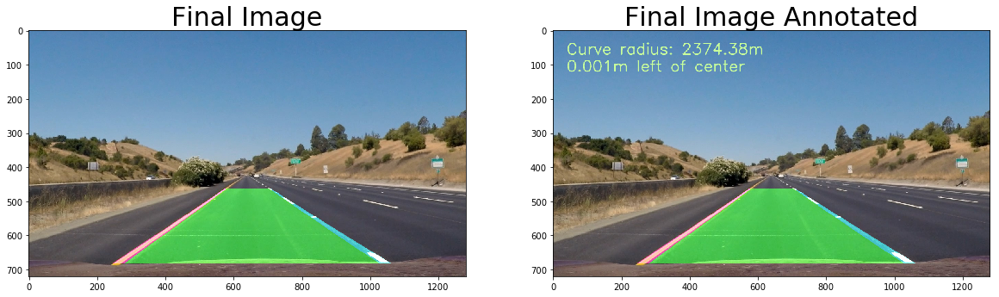

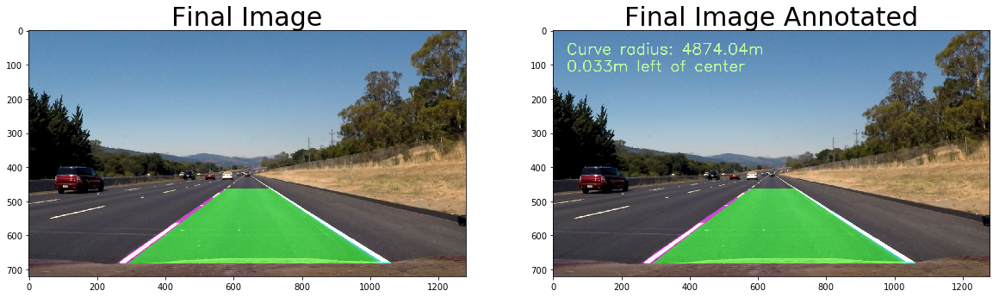

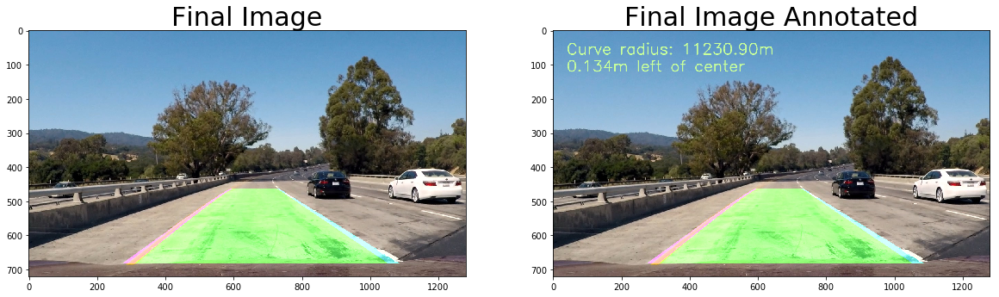

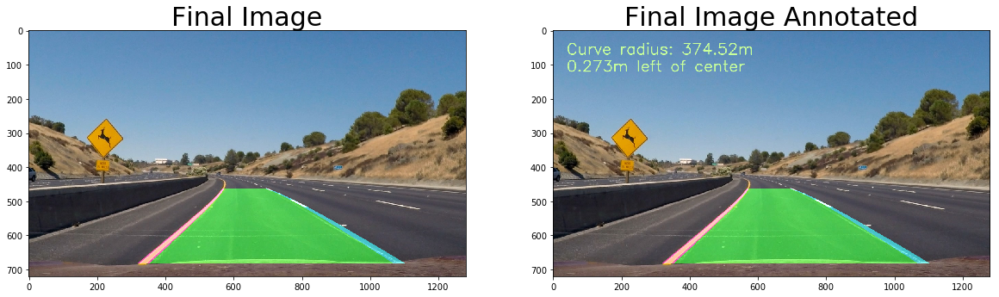

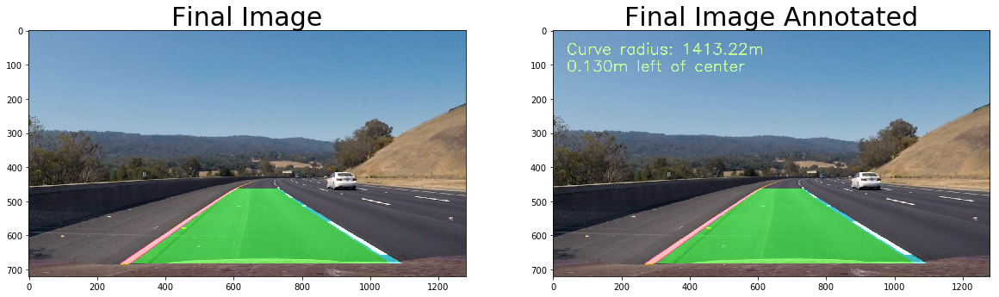

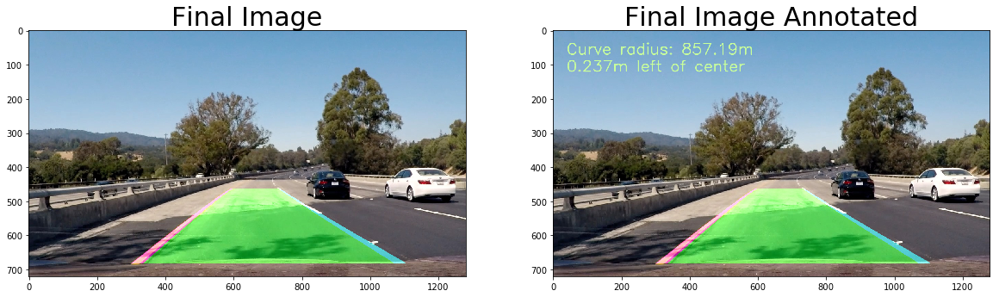

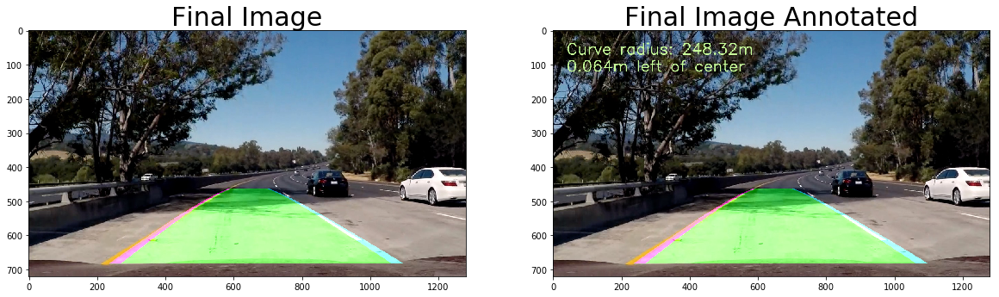

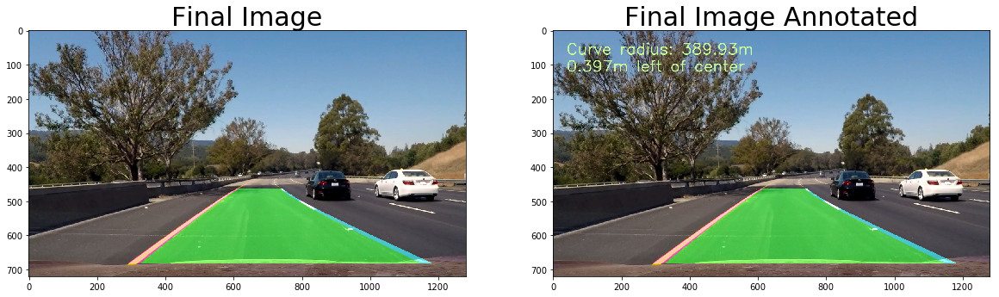

In [70]:
#Add text to images
for idx, fname in enumerate(starting_test_images):
    # Run the Absolute Threshold function
    input_image = cv2.imread(fname)
    input_image = cv2.cvtColor(input_image, cv2.COLOR_BGR2RGB)
    result = pipeline(input_image)
    left_fit, right_fit, left_lane_inds, right_lane_inds, visualization_data = orchestrate_sliding_windows(result)
    left_curve, right_curve, center = radius_of_curvature(result, left_fit, right_fit, left_lane_inds, right_lane_inds)
    final_painted_image = draw_lane_polygon(input_image, result, left_fit, right_fit, Minv)
    final_annotated_image = put_data_on_image(final_painted_image, (left_curve+right_curve)/2, center)
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 10))
    ax1.imshow(final_painted_image, cmap='gray')
    ax1.set_title('Final Image', fontsize=30)
    ax2.imshow(final_annotated_image, cmap='gray')
    ax2.set_title('Final Image Annotated', fontsize=30)

In [71]:
# Define a class to receive the characteristics of each line detection
class Line():
    def __init__(self):
        # was the line detected in the last iteration?
        self.detected = False  
        # x values of the last n fits of the line
        self.recent_xfitted = [] 
        #average x values of the fitted line over the last n iterations
        self.bestx = None     
        #polynomial coefficients averaged over the last n iterations
        self.best_fit = None  
        #polynomial coefficients for the most recent fit
        self.current_fit = []  
        #radius of curvature of the line in some units
        self.radius_of_curvature = None 
        #distance in meters of vehicle center from the line
        self.line_base_pos = None 
        #difference in fit coefficients between last and new fits
        self.diffs = np.array([0,0,0], dtype='float') 
        #number of detected pixels
        self.px_count = None
    
    def add_fit(self, fit, inds):
        # add a found fit to the line, up to n
        if fit is not None:
            if self.best_fit is not None:
                # if we have a best fit, see how this new fit compares
                self.diffs = abs(fit-self.best_fit)
            if (self.diffs[0] > 0.001 or \
               self.diffs[1] > 1.0 or \
               self.diffs[2] > 100.) and \
               len(self.current_fit) > 0:
                # bad fit! abort! abort! ... well, unless there are no fits in the current_fit queue, then we'll take it
                self.detected = False
            else:
                self.detected = True
                self.px_count = np.count_nonzero(inds)
                self.current_fit.append(fit)
                if len(self.current_fit) > 5:
                    # throw out old fits, keep newest n
                    self.current_fit = self.current_fit[len(self.current_fit)-5:]
                self.best_fit = np.average(self.current_fit, axis=0)
        # or remove one from the history, if not found
        else:
            self.detected = False
            if len(self.current_fit) > 0:
                # throw out oldest fit
                self.current_fit = self.current_fit[:len(self.current_fit)-1]
            if len(self.current_fit) > 0:
                # if there are still any fits in the queue, best_fit is their average
                self.best_fit = np.average(self.current_fit, axis=0)

In [111]:
def pipeline(input_image):
    #img = undistort_image(input_image)
    img = undistort(input_image)
    img, M, Minv = unwarp(img, src, dst)
    img = combined(img)
    return img, Minv

def orchestrate_image_stream(binary_warped, left_fit_prev, right_fit_prev):
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    margin = 80
    left_lane_inds = ((nonzerox > (left_fit_prev[0]*(nonzeroy**2) + left_fit_prev[1]*nonzeroy + left_fit_prev[2] - margin)) & 
                      (nonzerox < (left_fit_prev[0]*(nonzeroy**2) + left_fit_prev[1]*nonzeroy + left_fit_prev[2] + margin))) 
    right_lane_inds = ((nonzerox > (right_fit_prev[0]*(nonzeroy**2) + right_fit_prev[1]*nonzeroy + right_fit_prev[2] - margin)) & 
                       (nonzerox < (right_fit_prev[0]*(nonzeroy**2) + right_fit_prev[1]*nonzeroy + right_fit_prev[2] + margin)))  

    # Again, extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]
    
    left_fit_new, right_fit_new = (None, None)
    if len(leftx) != 0:
        # Fit a second order polynomial to each
        left_fit_new = np.polyfit(lefty, leftx, 2)
    if len(rightx) != 0:
        right_fit_new = np.polyfit(righty, rightx, 2)
    return left_fit_new, right_fit_new, left_lane_inds, right_lane_inds

def final_pipeline_process(img):
    new_img = np.copy(img)
#     new_img = cv2.cvtColor(new_img, cv2.COLOR_BGR2RGB)
    img_bin, Minv = pipeline(new_img)
    
    # if both left and right lines were detected last frame, use polyfit_using_prev_fit, otherwise use sliding window
    if not l_line.detected or not r_line.detected:
        l_fit, r_fit, l_lane_inds, r_lane_inds, _ = orchestrate_sliding_windows(img_bin)
    else:
        l_fit, r_fit, l_lane_inds, r_lane_inds = orchestrate_image_stream(img_bin, l_line.best_fit, r_line.best_fit)
        
    # invalidate both fits if the difference in their x-intercepts isn't around 350 px (+/- 100 px)
    if l_fit is not None and r_fit is not None:
        # calculate x-intercept (bottom of image, x=image_height) for fits
        h = img.shape[0]
        
        l_fit_x_int = l_fit[0]*h**2 + l_fit[1]*h + l_fit[2]
        r_fit_x_int = r_fit[0]*h**2 + r_fit[1]*h + r_fit[2]
        x_int_diff = abs(r_fit_x_int-l_fit_x_int)
        if abs(350 - x_int_diff) > 100:
            l_fit = None
            r_fit = None
            
    l_line.add_fit(l_fit, l_lane_inds)
    r_line.add_fit(r_fit, r_lane_inds)
    
    # draw the current best fit if it exists
    if l_line.best_fit is not None and r_line.best_fit is not None:
        img_out1 = draw_lane_polygon(new_img, img_bin, l_line.best_fit, r_line.best_fit, Minv)
        rad_l, rad_r, d_center = radius_of_curvature(img_bin, l_line.best_fit, r_line.best_fit, 
                                                               l_lane_inds, r_lane_inds)
        img_out = put_data_on_image(img_out1, (rad_l+rad_r)/2, d_center)
    else:
        img_out = new_img
    return img_out

## Step 9 Process Video Stream

In [112]:
from moviepy.editor import VideoFileClip
from IPython.display import HTML
l_line = Line()
r_line = Line()
video_output_1 = 'project_video_output.mp4'
video_input_1 = VideoFileClip('project_video.mp4')
processed_video = video_input_1.fl_image(final_pipeline_process)
%time processed_video.write_videofile(video_output_1, audio=False)

[MoviePy] >>>> Building video project_video_output.mp4
[MoviePy] Writing video project_video_output.mp4


100%|█████████▉| 1260/1261 [14:42<00:00,  1.41it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: project_video_output.mp4 

CPU times: user 32min 39s, sys: 1min 16s, total: 33min 56s
Wall time: 14min 43s


## Step 10 Process Challenge Video

In [ ]:
l_line = Line()
r_line = Line()
video_output_2 = 'challenge_video_output.mp4'
video_input_2 = VideoFileClip('challenge_video.mp4')
processed_video = video_input_2.fl_image(final_pipeline_process)
%time processed_video.write_videofile(video_input_2, audio=False)